# Afriat

In [1]:
scan=0.125

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: pzzu4ipt
Name: old-bothan-100
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/pzzu4ipt
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-pzzu4ipt/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2559,3244,9440
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2559,2569,1687,3454,1623,3351
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4476,10767
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 646,865,2299
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 646,633,421,836,426,848
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1108,2702
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:18:05, 13.83s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:18:05, 13.83s/it, v_num=pt_1, total_loss_train=3.7e+3, kl_local_train=56]

Epoch 2/600:   0%|          | 1/600 [00:13<2:18:05, 13.83s/it, v_num=pt_1, total_loss_train=3.7e+3, kl_local_train=56]

Epoch 2/600:   0%|          | 2/600 [00:26<2:11:04, 13.15s/it, v_num=pt_1, total_loss_train=3.7e+3, kl_local_train=56]

Epoch 2/600:   0%|          | 2/600 [00:26<2:11:04, 13.15s/it, v_num=pt_1, total_loss_train=3.22e+3, kl_local_train=84.2]

Epoch 3/600:   0%|          | 2/600 [00:26<2:11:04, 13.15s/it, v_num=pt_1, total_loss_train=3.22e+3, kl_local_train=84.2]

Epoch 3/600:   0%|          | 3/600 [00:39<2:08:08, 12.88s/it, v_num=pt_1, total_loss_train=3.22e+3, kl_local_train=84.2]

Epoch 3/600:   0%|          | 3/600 [00:39<2:08:08, 12.88s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=85.6]

Epoch 4/600:   0%|          | 3/600 [00:39<2:08:08, 12.88s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=85.6]

Epoch 4/600:   1%|          | 4/600 [00:51<2:06:43, 12.76s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=85.6]

Epoch 4/600:   1%|          | 4/600 [00:51<2:06:43, 12.76s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=82.1] 

Epoch 5/600:   1%|          | 4/600 [00:51<2:06:43, 12.76s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=82.1]

Epoch 5/600:   1%|          | 5/600 [01:04<2:06:31, 12.76s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=82.1]

Epoch 5/600:   1%|          | 5/600 [01:04<2:06:31, 12.76s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=75.4]

Epoch 6/600:   1%|          | 5/600 [01:05<2:06:31, 12.76s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=75.4]

Epoch 6/600:   1%|          | 6/600 [01:17<2:08:13, 12.95s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=75.4]

Epoch 6/600:   1%|          | 6/600 [01:17<2:08:13, 12.95s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 6/600 [01:17<2:08:13, 12.95s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 7/600 [01:29<2:05:15, 12.67s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 7/600:   1%|          | 7/600 [01:29<2:05:15, 12.67s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|          | 7/600 [01:29<2:05:15, 12.67s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▏         | 8/600 [01:41<2:03:07, 12.48s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 8/600:   1%|▏         | 8/600 [01:41<2:03:07, 12.48s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=32.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   1%|▏         | 8/600 [01:41<2:03:07, 12.48s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=32.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▏         | 9/600 [01:53<2:01:32, 12.34s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=32.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 9/600:   2%|▏         | 9/600 [01:53<2:01:32, 12.34s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=28.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 9/600 [01:53<2:01:32, 12.34s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=28.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 10/600 [02:06<2:00:47, 12.28s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=28.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 10/600:   2%|▏         | 10/600 [02:06<2:00:47, 12.28s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=32.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 10/600 [02:07<2:00:47, 12.28s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=32.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 11/600 [02:19<2:03:55, 12.62s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=32.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0351]

Epoch 11/600:   2%|▏         | 11/600 [02:19<2:03:55, 12.62s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491] 

Epoch 12/600:   2%|▏         | 11/600 [02:19<2:03:55, 12.62s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 12/600:   2%|▏         | 12/600 [02:31<2:01:56, 12.44s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 12/600:   2%|▏         | 12/600 [02:31<2:01:56, 12.44s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 13/600:   2%|▏         | 12/600 [02:31<2:01:56, 12.44s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 13/600:   2%|▏         | 13/600 [02:43<2:00:28, 12.31s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 13/600:   2%|▏         | 13/600 [02:43<2:00:28, 12.31s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 14/600:   2%|▏         | 13/600 [02:43<2:00:28, 12.31s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 14/600:   2%|▏         | 14/600 [02:55<1:59:22, 12.22s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 14/600:   2%|▏         | 14/600 [02:55<1:59:22, 12.22s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 15/600:   2%|▏         | 14/600 [02:55<1:59:22, 12.22s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 15/600:   2%|▎         | 15/600 [03:07<1:58:41, 12.17s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 15/600:   2%|▎         | 15/600 [03:07<1:58:41, 12.17s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=67.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 16/600:   2%|▎         | 15/600 [03:08<1:58:41, 12.17s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=67.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 16/600:   3%|▎         | 16/600 [03:20<2:01:59, 12.53s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=67.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0872, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0491]

Epoch 16/600:   3%|▎         | 16/600 [03:20<2:01:59, 12.53s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773] 

Epoch 17/600:   3%|▎         | 16/600 [03:20<2:01:59, 12.53s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 17/600:   3%|▎         | 17/600 [03:32<2:00:18, 12.38s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=72.5, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 17/600:   3%|▎         | 17/600 [03:32<2:00:18, 12.38s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=77.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 18/600:   3%|▎         | 17/600 [03:33<2:00:18, 12.38s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=77.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 18/600:   3%|▎         | 18/600 [03:45<1:59:02, 12.27s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=77.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 18/600:   3%|▎         | 18/600 [03:45<1:59:02, 12.27s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=82.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 19/600:   3%|▎         | 18/600 [03:45<1:59:02, 12.27s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=82.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 19/600:   3%|▎         | 19/600 [03:57<1:58:04, 12.19s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=82.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 19/600:   3%|▎         | 19/600 [03:57<1:58:04, 12.19s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=88, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]  

Epoch 20/600:   3%|▎         | 19/600 [03:57<1:58:04, 12.19s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=88, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 20/600:   3%|▎         | 20/600 [04:09<1:57:42, 12.18s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=88, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 20/600:   3%|▎         | 20/600 [04:09<1:57:42, 12.18s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=93.9, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 21/600:   3%|▎         | 20/600 [04:10<1:57:42, 12.18s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=93.9, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 21/600:   4%|▎         | 21/600 [04:22<2:01:06, 12.55s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=93.9, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0773]

Epoch 21/600:   4%|▎         | 21/600 [04:22<2:01:06, 12.55s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=97.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 22/600:   4%|▎         | 21/600 [04:22<2:01:06, 12.55s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=97.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 22/600:   4%|▎         | 22/600 [04:34<1:59:30, 12.41s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=97.5, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 22/600:   4%|▎         | 22/600 [04:34<1:59:30, 12.41s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=103, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952] 

Epoch 23/600:   4%|▎         | 22/600 [04:34<1:59:30, 12.41s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=103, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 23/600:   4%|▍         | 23/600 [04:46<1:58:21, 12.31s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=103, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 23/600:   4%|▍         | 23/600 [04:46<1:58:21, 12.31s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 24/600:   4%|▍         | 23/600 [04:46<1:58:21, 12.31s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 24/600:   4%|▍         | 24/600 [04:58<1:57:26, 12.23s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 24/600:   4%|▍         | 24/600 [04:58<1:57:26, 12.23s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 25/600:   4%|▍         | 24/600 [04:58<1:57:26, 12.23s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 25/600:   4%|▍         | 25/600 [05:10<1:56:51, 12.19s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 25/600:   4%|▍         | 25/600 [05:10<1:56:51, 12.19s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 26/600:   4%|▍         | 25/600 [05:12<1:56:51, 12.19s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 26/600:   4%|▍         | 26/600 [05:24<2:00:08, 12.56s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0952]

Epoch 26/600:   4%|▍         | 26/600 [05:24<2:00:08, 12.56s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]   

Epoch 27/600:   4%|▍         | 26/600 [05:24<2:00:08, 12.56s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 27/600:   4%|▍         | 27/600 [05:36<1:58:27, 12.40s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 27/600:   4%|▍         | 27/600 [05:36<1:58:27, 12.40s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 28/600:   4%|▍         | 27/600 [05:36<1:58:27, 12.40s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 28/600:   5%|▍         | 28/600 [05:48<1:57:17, 12.30s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 28/600:   5%|▍         | 28/600 [05:48<1:57:17, 12.30s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 28/600 [05:48<1:57:17, 12.30s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 29/600 [06:00<1:56:22, 12.23s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 29/600 [06:00<1:56:22, 12.23s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▍         | 29/600 [06:00<1:56:22, 12.23s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▌         | 30/600 [06:12<1:55:42, 12.18s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=118, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▌         | 30/600 [06:12<1:55:42, 12.18s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 30/600 [06:13<1:55:42, 12.18s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 31/600 [06:25<1:58:50, 12.53s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 31/600 [06:25<1:58:50, 12.53s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113] 

Epoch 32/600:   5%|▌         | 31/600 [06:25<1:58:50, 12.53s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 32/600:   5%|▌         | 32/600 [06:37<1:57:13, 12.38s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 32/600:   5%|▌         | 32/600 [06:37<1:57:13, 12.38s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 33/600:   5%|▌         | 32/600 [06:37<1:57:13, 12.38s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 33/600:   6%|▌         | 33/600 [06:49<1:56:04, 12.28s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 33/600:   6%|▌         | 33/600 [06:49<1:56:04, 12.28s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 34/600:   6%|▌         | 33/600 [06:49<1:56:04, 12.28s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 34/600:   6%|▌         | 34/600 [07:01<1:55:09, 12.21s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 34/600:   6%|▌         | 34/600 [07:01<1:55:09, 12.21s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 35/600:   6%|▌         | 34/600 [07:02<1:55:09, 12.21s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 35/600:   6%|▌         | 35/600 [07:14<1:54:49, 12.19s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 35/600:   6%|▌         | 35/600 [07:14<1:54:49, 12.19s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 36/600:   6%|▌         | 35/600 [07:15<1:54:49, 12.19s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 36/600:   6%|▌         | 36/600 [07:27<1:57:56, 12.55s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.113]

Epoch 36/600:   6%|▌         | 36/600 [07:27<1:57:56, 12.55s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 37/600:   6%|▌         | 36/600 [07:27<1:57:56, 12.55s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 37/600:   6%|▌         | 37/600 [07:39<1:56:19, 12.40s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 37/600:   6%|▌         | 37/600 [07:39<1:56:19, 12.40s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 38/600:   6%|▌         | 37/600 [07:39<1:56:19, 12.40s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 38/600:   6%|▋         | 38/600 [07:51<1:55:11, 12.30s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 38/600:   6%|▋         | 38/600 [07:51<1:55:11, 12.30s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 39/600:   6%|▋         | 38/600 [07:51<1:55:11, 12.30s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 39/600:   6%|▋         | 39/600 [08:03<1:54:15, 12.22s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 39/600:   6%|▋         | 39/600 [08:03<1:54:15, 12.22s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 40/600:   6%|▋         | 39/600 [08:03<1:54:15, 12.22s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 40/600:   7%|▋         | 40/600 [08:15<1:53:43, 12.19s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 40/600:   7%|▋         | 40/600 [08:15<1:53:43, 12.19s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116] 

Epoch 41/600:   7%|▋         | 40/600 [08:17<1:53:43, 12.19s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 41/600:   7%|▋         | 41/600 [08:29<1:56:50, 12.54s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.116]

Epoch 41/600:   7%|▋         | 41/600 [08:29<1:56:50, 12.54s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=98.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 42/600:   7%|▋         | 41/600 [08:29<1:56:50, 12.54s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=98.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 42/600:   7%|▋         | 42/600 [08:41<1:55:20, 12.40s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=98.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 42/600:   7%|▋         | 42/600 [08:41<1:55:20, 12.40s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]  

Epoch 43/600:   7%|▋         | 42/600 [08:41<1:55:20, 12.40s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 43/600:   7%|▋         | 43/600 [08:53<1:54:14, 12.31s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 43/600:   7%|▋         | 43/600 [08:53<1:54:14, 12.31s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=98.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 44/600:   7%|▋         | 43/600 [08:53<1:54:14, 12.31s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=98.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 44/600:   7%|▋         | 44/600 [09:05<1:53:25, 12.24s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=98.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 44/600:   7%|▋         | 44/600 [09:05<1:53:25, 12.24s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]  

Epoch 45/600:   7%|▋         | 44/600 [09:05<1:53:25, 12.24s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 45/600:   8%|▊         | 45/600 [09:17<1:53:05, 12.23s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 45/600:   8%|▊         | 45/600 [09:17<1:53:05, 12.23s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=99.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 46/600:   8%|▊         | 45/600 [09:18<1:53:05, 12.23s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=99.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 46/600:   8%|▊         | 46/600 [09:31<1:56:13, 12.59s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=99.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.119]

Epoch 46/600:   8%|▊         | 46/600 [09:31<1:56:13, 12.59s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 47/600:   8%|▊         | 46/600 [09:31<1:56:13, 12.59s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 47/600:   8%|▊         | 47/600 [09:43<1:55:03, 12.48s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 47/600:   8%|▊         | 47/600 [09:43<1:55:03, 12.48s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=99.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 48/600:   8%|▊         | 47/600 [09:43<1:55:03, 12.48s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=99.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 48/600:   8%|▊         | 48/600 [09:55<1:54:04, 12.40s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=99.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 48/600:   8%|▊         | 48/600 [09:55<1:54:04, 12.40s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=99.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 49/600:   8%|▊         | 48/600 [09:55<1:54:04, 12.40s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=99.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 49/600:   8%|▊         | 49/600 [10:07<1:53:02, 12.31s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=99.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 49/600:   8%|▊         | 49/600 [10:07<1:53:02, 12.31s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=98.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 50/600:   8%|▊         | 49/600 [10:07<1:53:02, 12.31s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=98.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 50/600:   8%|▊         | 50/600 [10:19<1:52:24, 12.26s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=98.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 50/600:   8%|▊         | 50/600 [10:19<1:52:24, 12.26s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=98.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 51/600:   8%|▊         | 50/600 [10:21<1:52:24, 12.26s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=98.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 51/600:   8%|▊         | 51/600 [10:33<1:55:15, 12.60s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=98.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.121]

Epoch 51/600:   8%|▊         | 51/600 [10:33<1:55:15, 12.60s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=99, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]  

Epoch 52/600:   8%|▊         | 51/600 [10:33<1:55:15, 12.60s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=99, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 52/600:   9%|▊         | 52/600 [10:45<1:53:37, 12.44s/it, v_num=pt_1, total_loss_train=3.21e+3, kl_local_train=99, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 52/600:   9%|▊         | 52/600 [10:45<1:53:37, 12.44s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=96.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 53/600:   9%|▊         | 52/600 [10:45<1:53:37, 12.44s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=96.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 53/600:   9%|▉         | 53/600 [10:57<1:52:19, 12.32s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=96.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 53/600:   9%|▉         | 53/600 [10:57<1:52:19, 12.32s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=95.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 54/600:   9%|▉         | 53/600 [10:57<1:52:19, 12.32s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=95.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 54/600:   9%|▉         | 54/600 [11:09<1:51:24, 12.24s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=95.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 54/600:   9%|▉         | 54/600 [11:09<1:51:24, 12.24s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 55/600:   9%|▉         | 54/600 [11:09<1:51:24, 12.24s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 55/600:   9%|▉         | 55/600 [11:21<1:51:58, 12.33s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 55/600:   9%|▉         | 55/600 [11:21<1:51:58, 12.33s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 56/600:   9%|▉         | 55/600 [11:23<1:51:58, 12.33s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 56/600:   9%|▉         | 56/600 [11:35<1:54:36, 12.64s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=94.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.123]

Epoch 56/600:   9%|▉         | 56/600 [11:35<1:54:36, 12.64s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 57/600:   9%|▉         | 56/600 [11:35<1:54:36, 12.64s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 57/600:  10%|▉         | 57/600 [11:47<1:52:49, 12.47s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 57/600:  10%|▉         | 57/600 [11:47<1:52:49, 12.47s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=92.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 58/600:  10%|▉         | 57/600 [11:47<1:52:49, 12.47s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=92.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 58/600:  10%|▉         | 58/600 [11:59<1:51:30, 12.34s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=92.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 58/600:  10%|▉         | 58/600 [11:59<1:51:30, 12.34s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=92.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 59/600:  10%|▉         | 58/600 [11:59<1:51:30, 12.34s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=92.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 59/600:  10%|▉         | 59/600 [12:11<1:50:34, 12.26s/it, v_num=pt_1, total_loss_train=3.2e+3, kl_local_train=92.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 59/600:  10%|▉         | 59/600 [12:11<1:50:34, 12.26s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=91, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122] 

Epoch 60/600:  10%|▉         | 59/600 [12:11<1:50:34, 12.26s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=91, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 60/600:  10%|█         | 60/600 [12:23<1:49:58, 12.22s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=91, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 60/600:  10%|█         | 60/600 [12:23<1:49:58, 12.22s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=90.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 61/600:  10%|█         | 60/600 [12:24<1:49:58, 12.22s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=90.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 61/600:  10%|█         | 61/600 [12:36<1:52:54, 12.57s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=90.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 61/600:  10%|█         | 61/600 [12:36<1:52:54, 12.57s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=89.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 62/600:  10%|█         | 61/600 [12:36<1:52:54, 12.57s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=89.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 62/600:  10%|█         | 62/600 [12:48<1:51:25, 12.43s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=89.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 62/600:  10%|█         | 62/600 [12:48<1:51:25, 12.43s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=88.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 63/600:  10%|█         | 62/600 [12:48<1:51:25, 12.43s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=88.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 63/600:  10%|█         | 63/600 [13:01<1:50:20, 12.33s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=88.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 63/600:  10%|█         | 63/600 [13:01<1:50:20, 12.33s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=88.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 64/600:  10%|█         | 63/600 [13:01<1:50:20, 12.33s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=88.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 64/600:  11%|█         | 64/600 [13:13<1:49:30, 12.26s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=88.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 64/600:  11%|█         | 64/600 [13:13<1:49:30, 12.26s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=87.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 65/600:  11%|█         | 64/600 [13:13<1:49:30, 12.26s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=87.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 65/600:  11%|█         | 65/600 [13:25<1:48:58, 12.22s/it, v_num=pt_1, total_loss_train=3.19e+3, kl_local_train=87.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 65/600:  11%|█         | 65/600 [13:25<1:48:58, 12.22s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=86.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 66/600:  11%|█         | 65/600 [13:26<1:48:58, 12.22s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=86.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 66/600:  11%|█         | 66/600 [13:38<1:52:00, 12.59s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=86.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 66/600:  11%|█         | 66/600 [13:38<1:52:00, 12.59s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 67/600:  11%|█         | 66/600 [13:38<1:52:00, 12.59s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 67/600:  11%|█         | 67/600 [13:50<1:50:33, 12.45s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 67/600:  11%|█         | 67/600 [13:50<1:50:33, 12.45s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=85.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 68/600:  11%|█         | 67/600 [13:50<1:50:33, 12.45s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=85.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 68/600:  11%|█▏        | 68/600 [14:02<1:49:30, 12.35s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=85.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 68/600:  11%|█▏        | 68/600 [14:02<1:49:30, 12.35s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=84.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 69/600:  11%|█▏        | 68/600 [14:02<1:49:30, 12.35s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=84.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 69/600:  12%|█▏        | 69/600 [14:15<1:48:44, 12.29s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=84.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 69/600:  12%|█▏        | 69/600 [14:15<1:48:44, 12.29s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=83.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 70/600:  12%|█▏        | 69/600 [14:15<1:48:44, 12.29s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=83.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 70/600:  12%|█▏        | 70/600 [14:27<1:47:58, 12.22s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=83.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 70/600:  12%|█▏        | 70/600 [14:27<1:47:58, 12.22s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=83.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 71/600:  12%|█▏        | 70/600 [14:28<1:47:58, 12.22s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=83.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 71/600:  12%|█▏        | 71/600 [14:40<1:51:01, 12.59s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=83.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 71/600:  12%|█▏        | 71/600 [14:40<1:51:01, 12.59s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=83, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]   

Epoch 72/600:  12%|█▏        | 71/600 [14:40<1:51:01, 12.59s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=83, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|█▏        | 72/600 [14:52<1:49:56, 12.49s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=83, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|█▏        | 72/600 [14:52<1:49:56, 12.49s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=82.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 72/600 [14:52<1:49:56, 12.49s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=82.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 73/600 [15:05<1:48:51, 12.39s/it, v_num=pt_1, total_loss_train=3.18e+3, kl_local_train=82.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 73/600 [15:05<1:48:51, 12.39s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=82.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|█▏        | 73/600 [15:05<1:48:51, 12.39s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=82.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|█▏        | 74/600 [15:17<1:48:08, 12.33s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=82.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|█▏        | 74/600 [15:17<1:48:08, 12.33s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=81.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|█▏        | 74/600 [15:17<1:48:08, 12.33s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=81.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|█▎        | 75/600 [15:29<1:47:25, 12.28s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=81.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|█▎        | 75/600 [15:29<1:47:25, 12.28s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=80.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 76/600:  12%|█▎        | 75/600 [15:30<1:47:25, 12.28s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=80.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 76/600:  13%|█▎        | 76/600 [15:42<1:50:20, 12.63s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=80.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 76/600:  13%|█▎        | 76/600 [15:42<1:50:20, 12.63s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=79.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 76/600 [15:42<1:50:20, 12.63s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=79.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 77/600 [15:55<1:48:47, 12.48s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=79.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 77/600 [15:55<1:48:47, 12.48s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]  

Epoch 78/600:  13%|█▎        | 77/600 [15:55<1:48:47, 12.48s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 78/600 [16:07<1:47:40, 12.38s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=80, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 78/600 [16:07<1:47:40, 12.38s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=78.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 78/600 [16:07<1:47:40, 12.38s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=78.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 79/600 [16:19<1:46:51, 12.31s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=78.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 79/600 [16:19<1:46:51, 12.31s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]  

Epoch 80/600:  13%|█▎        | 79/600 [16:19<1:46:51, 12.31s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 80/600 [16:31<1:46:10, 12.25s/it, v_num=pt_1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 80/600 [16:31<1:46:10, 12.25s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 81/600:  13%|█▎        | 80/600 [16:32<1:46:10, 12.25s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 81/600:  14%|█▎        | 81/600 [16:44<1:49:03, 12.61s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=78.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 81/600:  14%|█▎        | 81/600 [16:44<1:49:03, 12.61s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 82/600:  14%|█▎        | 81/600 [16:44<1:49:03, 12.61s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 82/600:  14%|█▎        | 82/600 [16:57<1:47:42, 12.48s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 82/600:  14%|█▎        | 82/600 [16:57<1:47:42, 12.48s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=77.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 83/600:  14%|█▎        | 82/600 [16:57<1:47:42, 12.48s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=77.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 83/600:  14%|█▍        | 83/600 [17:09<1:46:41, 12.38s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=77.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 83/600:  14%|█▍        | 83/600 [17:09<1:46:41, 12.38s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 84/600:  14%|█▍        | 83/600 [17:09<1:46:41, 12.38s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 84/600:  14%|█▍        | 84/600 [17:21<1:45:52, 12.31s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 84/600:  14%|█▍        | 84/600 [17:21<1:45:52, 12.31s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 85/600:  14%|█▍        | 84/600 [17:21<1:45:52, 12.31s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 85/600:  14%|█▍        | 85/600 [17:33<1:45:12, 12.26s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 85/600:  14%|█▍        | 85/600 [17:33<1:45:12, 12.26s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=76.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 86/600:  14%|█▍        | 85/600 [17:34<1:45:12, 12.26s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=76.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 86/600:  14%|█▍        | 86/600 [17:46<1:48:04, 12.62s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=76.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 86/600:  14%|█▍        | 86/600 [17:46<1:48:04, 12.62s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 87/600:  14%|█▍        | 86/600 [17:46<1:48:04, 12.62s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 87/600:  14%|█▍        | 87/600 [17:59<1:46:37, 12.47s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 87/600:  14%|█▍        | 87/600 [17:59<1:46:37, 12.47s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 88/600:  14%|█▍        | 87/600 [17:59<1:46:37, 12.47s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 88/600:  15%|█▍        | 88/600 [18:11<1:45:34, 12.37s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 88/600:  15%|█▍        | 88/600 [18:11<1:45:34, 12.37s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 89/600:  15%|█▍        | 88/600 [18:11<1:45:34, 12.37s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 89/600:  15%|█▍        | 89/600 [18:23<1:44:46, 12.30s/it, v_num=pt_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 89/600:  15%|█▍        | 89/600 [18:23<1:44:46, 12.30s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 90/600:  15%|█▍        | 89/600 [18:23<1:44:46, 12.30s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 90/600:  15%|█▌        | 90/600 [18:35<1:44:15, 12.26s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 90/600:  15%|█▌        | 90/600 [18:35<1:44:15, 12.26s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=74.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 91/600:  15%|█▌        | 90/600 [18:36<1:44:15, 12.26s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=74.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 91/600:  15%|█▌        | 91/600 [18:48<1:47:04, 12.62s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=74.6, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 91/600:  15%|█▌        | 91/600 [18:48<1:47:04, 12.62s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 92/600:  15%|█▌        | 91/600 [18:48<1:47:04, 12.62s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 92/600:  15%|█▌        | 92/600 [19:01<1:45:41, 12.48s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 92/600:  15%|█▌        | 92/600 [19:01<1:45:41, 12.48s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 93/600:  15%|█▌        | 92/600 [19:01<1:45:41, 12.48s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 93/600:  16%|█▌        | 93/600 [19:13<1:44:40, 12.39s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 93/600:  16%|█▌        | 93/600 [19:13<1:44:40, 12.39s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 94/600:  16%|█▌        | 93/600 [19:13<1:44:40, 12.39s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 94/600:  16%|█▌        | 94/600 [19:25<1:43:53, 12.32s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 94/600:  16%|█▌        | 94/600 [19:25<1:43:53, 12.32s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 95/600:  16%|█▌        | 94/600 [19:25<1:43:53, 12.32s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 95/600:  16%|█▌        | 95/600 [19:37<1:43:13, 12.26s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=73.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 95/600:  16%|█▌        | 95/600 [19:37<1:43:13, 12.26s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 96/600:  16%|█▌        | 95/600 [19:38<1:43:13, 12.26s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 96/600:  16%|█▌        | 96/600 [19:51<1:46:08, 12.64s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 96/600:  16%|█▌        | 96/600 [19:51<1:46:08, 12.64s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=72.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108] 

Epoch 97/600:  16%|█▌        | 96/600 [19:51<1:46:08, 12.64s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=72.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 97/600:  16%|█▌        | 97/600 [20:03<1:45:00, 12.53s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=72.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 97/600:  16%|█▌        | 97/600 [20:03<1:45:00, 12.53s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 98/600:  16%|█▌        | 97/600 [20:03<1:45:00, 12.53s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 98/600:  16%|█▋        | 98/600 [20:15<1:43:57, 12.42s/it, v_num=pt_1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 98/600:  16%|█▋        | 98/600 [20:15<1:43:57, 12.42s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=71.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 99/600:  16%|█▋        | 98/600 [20:15<1:43:57, 12.42s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=71.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 99/600:  16%|█▋        | 99/600 [20:27<1:43:06, 12.35s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=71.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 99/600:  16%|█▋        | 99/600 [20:27<1:43:06, 12.35s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 100/600:  16%|█▋        | 99/600 [20:27<1:43:06, 12.35s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 100/600:  17%|█▋        | 100/600 [20:39<1:42:15, 12.27s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 100/600:  17%|█▋        | 100/600 [20:39<1:42:15, 12.27s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 101/600:  17%|█▋        | 100/600 [20:41<1:42:15, 12.27s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 101/600:  17%|█▋        | 101/600 [20:53<1:45:01, 12.63s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 101/600:  17%|█▋        | 101/600 [20:53<1:45:01, 12.63s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 102/600:  17%|█▋        | 101/600 [20:53<1:45:01, 12.63s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 102/600:  17%|█▋        | 102/600 [21:05<1:43:35, 12.48s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 102/600:  17%|█▋        | 102/600 [21:05<1:43:35, 12.48s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 103/600:  17%|█▋        | 102/600 [21:05<1:43:35, 12.48s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 103/600:  17%|█▋        | 103/600 [21:17<1:42:32, 12.38s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 103/600:  17%|█▋        | 103/600 [21:17<1:42:32, 12.38s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 104/600:  17%|█▋        | 103/600 [21:17<1:42:32, 12.38s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 104/600:  17%|█▋        | 104/600 [21:29<1:41:43, 12.31s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 104/600:  17%|█▋        | 104/600 [21:29<1:41:43, 12.31s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=69.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 105/600:  17%|█▋        | 104/600 [21:29<1:41:43, 12.31s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=69.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 105/600:  18%|█▊        | 105/600 [21:41<1:41:00, 12.24s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=69.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 105/600:  18%|█▊        | 105/600 [21:41<1:41:00, 12.24s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=69, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]  

Epoch 106/600:  18%|█▊        | 105/600 [21:43<1:41:00, 12.24s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=69, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 106/600:  18%|█▊        | 106/600 [21:55<1:43:49, 12.61s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=69, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 106/600:  18%|█▊        | 106/600 [21:55<1:43:49, 12.61s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 107/600:  18%|█▊        | 106/600 [21:55<1:43:49, 12.61s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 107/600:  18%|█▊        | 107/600 [22:07<1:42:30, 12.47s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 107/600:  18%|█▊        | 107/600 [22:07<1:42:30, 12.47s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 108/600:  18%|█▊        | 107/600 [22:07<1:42:30, 12.47s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 108/600:  18%|█▊        | 108/600 [22:19<1:41:29, 12.38s/it, v_num=pt_1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 108/600:  18%|█▊        | 108/600 [22:19<1:41:29, 12.38s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=68.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 109/600:  18%|█▊        | 108/600 [22:19<1:41:29, 12.38s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=68.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 109/600:  18%|█▊        | 109/600 [22:31<1:40:42, 12.31s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=68.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 109/600:  18%|█▊        | 109/600 [22:31<1:40:42, 12.31s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 110/600:  18%|█▊        | 109/600 [22:31<1:40:42, 12.31s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 110/600:  18%|█▊        | 110/600 [22:43<1:40:03, 12.25s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 110/600:  18%|█▊        | 110/600 [22:43<1:40:03, 12.25s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]  

Epoch 111/600:  18%|█▊        | 110/600 [22:45<1:40:03, 12.25s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 111/600:  18%|█▊        | 111/600 [22:57<1:42:45, 12.61s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 111/600:  18%|█▊        | 111/600 [22:57<1:42:45, 12.61s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 112/600:  18%|█▊        | 111/600 [22:57<1:42:45, 12.61s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 112/600:  19%|█▊        | 112/600 [23:09<1:41:25, 12.47s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 112/600:  19%|█▊        | 112/600 [23:09<1:41:25, 12.47s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 113/600:  19%|█▊        | 112/600 [23:09<1:41:25, 12.47s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 113/600:  19%|█▉        | 113/600 [23:21<1:40:25, 12.37s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 113/600:  19%|█▉        | 113/600 [23:21<1:40:25, 12.37s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 114/600:  19%|█▉        | 113/600 [23:21<1:40:25, 12.37s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 114/600:  19%|█▉        | 114/600 [23:33<1:39:37, 12.30s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 114/600:  19%|█▉        | 114/600 [23:33<1:39:37, 12.30s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 115/600:  19%|█▉        | 114/600 [23:33<1:39:37, 12.30s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 115/600:  19%|█▉        | 115/600 [23:45<1:38:55, 12.24s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=67.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 115/600:  19%|█▉        | 115/600 [23:45<1:38:55, 12.24s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 116/600:  19%|█▉        | 115/600 [23:47<1:38:55, 12.24s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 116/600:  19%|█▉        | 116/600 [23:59<1:41:44, 12.61s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.0978, metric_mi|mouse_train=0.102]

Epoch 116/600:  19%|█▉        | 116/600 [23:59<1:41:44, 12.61s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 117/600:  19%|█▉        | 116/600 [23:59<1:41:44, 12.61s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 117/600:  20%|█▉        | 117/600 [24:11<1:40:25, 12.47s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 117/600:  20%|█▉        | 117/600 [24:11<1:40:25, 12.47s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 118/600:  20%|█▉        | 117/600 [24:11<1:40:25, 12.47s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 118/600:  20%|█▉        | 118/600 [24:23<1:39:25, 12.38s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 118/600:  20%|█▉        | 118/600 [24:23<1:39:25, 12.38s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 119/600:  20%|█▉        | 118/600 [24:23<1:39:25, 12.38s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 119/600:  20%|█▉        | 119/600 [24:35<1:38:38, 12.30s/it, v_num=pt_1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 119/600:  20%|█▉        | 119/600 [24:35<1:38:38, 12.30s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 120/600:  20%|█▉        | 119/600 [24:35<1:38:38, 12.30s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 120/600:  20%|██        | 120/600 [24:47<1:37:59, 12.25s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 120/600:  20%|██        | 120/600 [24:47<1:37:59, 12.25s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 121/600:  20%|██        | 120/600 [24:49<1:37:59, 12.25s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 121/600:  20%|██        | 121/600 [25:01<1:40:57, 12.65s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.0946, metric_mi|mouse_train=0.0997]

Epoch 121/600:  20%|██        | 121/600 [25:01<1:40:57, 12.65s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]  

Epoch 122/600:  20%|██        | 121/600 [25:01<1:40:57, 12.65s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 122/600:  20%|██        | 122/600 [25:13<1:40:04, 12.56s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 122/600:  20%|██        | 122/600 [25:13<1:40:04, 12.56s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 123/600:  20%|██        | 122/600 [25:13<1:40:04, 12.56s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 123/600:  20%|██        | 123/600 [25:25<1:39:08, 12.47s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 123/600:  20%|██        | 123/600 [25:26<1:39:08, 12.47s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 124/600:  20%|██        | 123/600 [25:26<1:39:08, 12.47s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 124/600:  21%|██        | 124/600 [25:38<1:38:28, 12.41s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 124/600:  21%|██        | 124/600 [25:38<1:38:28, 12.41s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 125/600:  21%|██        | 124/600 [25:38<1:38:28, 12.41s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 125/600:  21%|██        | 125/600 [25:50<1:37:45, 12.35s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 125/600:  21%|██        | 125/600 [25:50<1:37:45, 12.35s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 126/600:  21%|██        | 125/600 [25:51<1:37:45, 12.35s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 126/600:  21%|██        | 126/600 [26:04<1:40:29, 12.72s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.099]

Epoch 126/600:  21%|██        | 126/600 [26:04<1:40:29, 12.72s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 127/600:  21%|██        | 126/600 [26:04<1:40:29, 12.72s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 127/600:  21%|██        | 127/600 [26:16<1:39:10, 12.58s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 127/600:  21%|██        | 127/600 [26:16<1:39:10, 12.58s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 128/600:  21%|██        | 127/600 [26:16<1:39:10, 12.58s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 128/600:  21%|██▏       | 128/600 [26:28<1:38:12, 12.48s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 128/600:  21%|██▏       | 128/600 [26:28<1:38:12, 12.48s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 129/600:  21%|██▏       | 128/600 [26:28<1:38:12, 12.48s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 129/600:  22%|██▏       | 129/600 [26:40<1:37:29, 12.42s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 129/600:  22%|██▏       | 129/600 [26:40<1:37:29, 12.42s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 130/600:  22%|██▏       | 129/600 [26:40<1:37:29, 12.42s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 130/600:  22%|██▏       | 130/600 [26:53<1:37:10, 12.41s/it, v_num=pt_1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 130/600:  22%|██▏       | 130/600 [26:53<1:37:10, 12.41s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 131/600:  22%|██▏       | 130/600 [26:54<1:37:10, 12.41s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 131/600:  22%|██▏       | 131/600 [27:06<1:39:42, 12.76s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0989]

Epoch 131/600:  22%|██▏       | 131/600 [27:06<1:39:42, 12.76s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 132/600:  22%|██▏       | 131/600 [27:06<1:39:42, 12.76s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 132/600:  22%|██▏       | 132/600 [27:19<1:38:21, 12.61s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 132/600:  22%|██▏       | 132/600 [27:19<1:38:21, 12.61s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 133/600:  22%|██▏       | 132/600 [27:19<1:38:21, 12.61s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 133/600:  22%|██▏       | 133/600 [27:31<1:37:21, 12.51s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 133/600:  22%|██▏       | 133/600 [27:31<1:37:21, 12.51s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 134/600:  22%|██▏       | 133/600 [27:31<1:37:21, 12.51s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 134/600:  22%|██▏       | 134/600 [27:43<1:36:36, 12.44s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 134/600:  22%|██▏       | 134/600 [27:43<1:36:36, 12.44s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 135/600:  22%|██▏       | 134/600 [27:43<1:36:36, 12.44s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 135/600:  22%|██▎       | 135/600 [27:55<1:35:50, 12.37s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 135/600:  22%|██▎       | 135/600 [27:55<1:35:50, 12.37s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 136/600:  22%|██▎       | 135/600 [27:57<1:35:50, 12.37s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 136/600:  23%|██▎       | 136/600 [28:09<1:38:27, 12.73s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0936, metric_mi|mouse_train=0.0988]

Epoch 136/600:  23%|██▎       | 136/600 [28:09<1:38:27, 12.73s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 137/600:  23%|██▎       | 136/600 [28:09<1:38:27, 12.73s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 137/600:  23%|██▎       | 137/600 [28:21<1:37:11, 12.60s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 137/600:  23%|██▎       | 137/600 [28:21<1:37:11, 12.60s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 138/600:  23%|██▎       | 137/600 [28:21<1:37:11, 12.60s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 138/600:  23%|██▎       | 138/600 [28:33<1:36:13, 12.50s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 138/600:  23%|██▎       | 138/600 [28:33<1:36:13, 12.50s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 139/600:  23%|██▎       | 138/600 [28:33<1:36:13, 12.50s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 139/600:  23%|██▎       | 139/600 [28:46<1:35:29, 12.43s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 139/600:  23%|██▎       | 139/600 [28:46<1:35:29, 12.43s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 140/600:  23%|██▎       | 139/600 [28:46<1:35:29, 12.43s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 140/600:  23%|██▎       | 140/600 [28:58<1:34:43, 12.35s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 140/600:  23%|██▎       | 140/600 [28:58<1:34:43, 12.35s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 141/600:  23%|██▎       | 140/600 [28:59<1:34:43, 12.35s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 141/600:  24%|██▎       | 141/600 [29:11<1:37:17, 12.72s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.0981]

Epoch 141/600:  24%|██▎       | 141/600 [29:11<1:37:17, 12.72s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 142/600:  24%|██▎       | 141/600 [29:11<1:37:17, 12.72s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 142/600:  24%|██▎       | 142/600 [29:24<1:36:04, 12.59s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 142/600:  24%|██▎       | 142/600 [29:24<1:36:04, 12.59s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 143/600:  24%|██▎       | 142/600 [29:24<1:36:04, 12.59s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 143/600:  24%|██▍       | 143/600 [29:36<1:35:11, 12.50s/it, v_num=pt_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 143/600:  24%|██▍       | 143/600 [29:36<1:35:11, 12.50s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974] 

Epoch 144/600:  24%|██▍       | 143/600 [29:36<1:35:11, 12.50s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 144/600:  24%|██▍       | 144/600 [29:48<1:34:29, 12.43s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 144/600:  24%|██▍       | 144/600 [29:48<1:34:29, 12.43s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 145/600:  24%|██▍       | 144/600 [29:48<1:34:29, 12.43s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 145/600:  24%|██▍       | 145/600 [30:01<1:33:58, 12.39s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 145/600:  24%|██▍       | 145/600 [30:01<1:33:58, 12.39s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 146/600:  24%|██▍       | 145/600 [30:02<1:33:58, 12.39s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 146/600:  24%|██▍       | 146/600 [30:14<1:36:34, 12.76s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0919, metric_mi|mouse_train=0.0974]

Epoch 146/600:  24%|██▍       | 146/600 [30:14<1:36:34, 12.76s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968] 

Epoch 147/600:  24%|██▍       | 146/600 [30:14<1:36:34, 12.76s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 147/600:  24%|██▍       | 147/600 [30:27<1:35:16, 12.62s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 147/600:  24%|██▍       | 147/600 [30:27<1:35:16, 12.62s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 148/600:  24%|██▍       | 147/600 [30:27<1:35:16, 12.62s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 148/600:  25%|██▍       | 148/600 [30:39<1:34:24, 12.53s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 148/600:  25%|██▍       | 148/600 [30:39<1:34:24, 12.53s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 149/600:  25%|██▍       | 148/600 [30:39<1:34:24, 12.53s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 149/600:  25%|██▍       | 149/600 [30:51<1:33:38, 12.46s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 149/600:  25%|██▍       | 149/600 [30:51<1:33:38, 12.46s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 150/600:  25%|██▍       | 149/600 [30:51<1:33:38, 12.46s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 150/600:  25%|██▌       | 150/600 [31:03<1:33:00, 12.40s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 150/600:  25%|██▌       | 150/600 [31:03<1:33:00, 12.40s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 151/600:  25%|██▌       | 150/600 [31:05<1:33:00, 12.40s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 151/600:  25%|██▌       | 151/600 [31:17<1:35:27, 12.76s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.0968]

Epoch 151/600:  25%|██▌       | 151/600 [31:17<1:35:27, 12.76s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964] 

Epoch 152/600:  25%|██▌       | 151/600 [31:17<1:35:27, 12.76s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 152/600:  25%|██▌       | 152/600 [31:29<1:34:07, 12.61s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 152/600:  25%|██▌       | 152/600 [31:29<1:34:07, 12.61s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 153/600:  25%|██▌       | 152/600 [31:29<1:34:07, 12.61s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 153/600:  26%|██▌       | 153/600 [31:41<1:33:09, 12.50s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 153/600:  26%|██▌       | 153/600 [31:42<1:33:09, 12.50s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 154/600:  26%|██▌       | 153/600 [31:42<1:33:09, 12.50s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 154/600:  26%|██▌       | 154/600 [31:54<1:32:25, 12.43s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 154/600:  26%|██▌       | 154/600 [31:54<1:32:25, 12.43s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 155/600:  26%|██▌       | 154/600 [31:54<1:32:25, 12.43s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 155/600:  26%|██▌       | 155/600 [32:06<1:32:16, 12.44s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 155/600:  26%|██▌       | 155/600 [32:06<1:32:16, 12.44s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 156/600:  26%|██▌       | 155/600 [32:08<1:32:16, 12.44s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 156/600:  26%|██▌       | 156/600 [32:20<1:34:35, 12.78s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0907, metric_mi|mouse_train=0.0964]

Epoch 156/600:  26%|██▌       | 156/600 [32:20<1:34:35, 12.78s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951] 

Epoch 157/600:  26%|██▌       | 156/600 [32:20<1:34:35, 12.78s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 157/600:  26%|██▌       | 157/600 [32:32<1:33:13, 12.63s/it, v_num=pt_1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 157/600:  26%|██▌       | 157/600 [32:32<1:33:13, 12.63s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 158/600:  26%|██▌       | 157/600 [32:32<1:33:13, 12.63s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 158/600:  26%|██▋       | 158/600 [32:44<1:32:13, 12.52s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 158/600:  26%|██▋       | 158/600 [32:44<1:32:13, 12.52s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 159/600:  26%|██▋       | 158/600 [32:44<1:32:13, 12.52s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 159/600:  26%|██▋       | 159/600 [32:57<1:31:25, 12.44s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 159/600:  26%|██▋       | 159/600 [32:57<1:31:25, 12.44s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 160/600:  26%|██▋       | 159/600 [32:57<1:31:25, 12.44s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 160/600:  27%|██▋       | 160/600 [33:09<1:31:05, 12.42s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 160/600:  27%|██▋       | 160/600 [33:09<1:31:05, 12.42s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 161/600:  27%|██▋       | 160/600 [33:10<1:31:05, 12.42s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 161/600:  27%|██▋       | 161/600 [33:23<1:33:25, 12.77s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.089, metric_mi|mouse_train=0.0951]

Epoch 161/600:  27%|██▋       | 161/600 [33:23<1:33:25, 12.77s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 162/600:  27%|██▋       | 161/600 [33:23<1:33:25, 12.77s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 162/600:  27%|██▋       | 162/600 [33:35<1:32:06, 12.62s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 162/600:  27%|██▋       | 162/600 [33:35<1:32:06, 12.62s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 163/600:  27%|██▋       | 162/600 [33:35<1:32:06, 12.62s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 163/600:  27%|██▋       | 163/600 [33:47<1:31:03, 12.50s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 163/600:  27%|██▋       | 163/600 [33:47<1:31:03, 12.50s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 164/600:  27%|██▋       | 163/600 [33:47<1:31:03, 12.50s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 164/600:  27%|██▋       | 164/600 [33:59<1:30:17, 12.43s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 164/600:  27%|██▋       | 164/600 [33:59<1:30:17, 12.43s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 165/600:  27%|██▋       | 164/600 [33:59<1:30:17, 12.43s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 165/600:  28%|██▊       | 165/600 [34:11<1:29:31, 12.35s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 165/600:  28%|██▊       | 165/600 [34:11<1:29:31, 12.35s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 166/600:  28%|██▊       | 165/600 [34:13<1:29:31, 12.35s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 166/600:  28%|██▊       | 166/600 [34:25<1:31:58, 12.71s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0944]

Epoch 166/600:  28%|██▊       | 166/600 [34:25<1:31:58, 12.71s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 167/600:  28%|██▊       | 166/600 [34:25<1:31:58, 12.71s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 167/600:  28%|██▊       | 167/600 [34:37<1:30:46, 12.58s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 167/600:  28%|██▊       | 167/600 [34:37<1:30:46, 12.58s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 168/600:  28%|██▊       | 167/600 [34:37<1:30:46, 12.58s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 168/600:  28%|██▊       | 168/600 [34:50<1:29:53, 12.49s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 168/600:  28%|██▊       | 168/600 [34:50<1:29:53, 12.49s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 169/600:  28%|██▊       | 168/600 [34:50<1:29:53, 12.49s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 169/600:  28%|██▊       | 169/600 [35:02<1:29:10, 12.41s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 169/600:  28%|██▊       | 169/600 [35:02<1:29:10, 12.41s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 170/600:  28%|██▊       | 169/600 [35:02<1:29:10, 12.41s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 170/600:  28%|██▊       | 170/600 [35:14<1:28:47, 12.39s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 170/600:  28%|██▊       | 170/600 [35:14<1:28:47, 12.39s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 171/600:  28%|██▊       | 170/600 [35:15<1:28:47, 12.39s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 171/600:  28%|██▊       | 171/600 [35:28<1:31:14, 12.76s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0932]

Epoch 171/600:  28%|██▊       | 171/600 [35:28<1:31:14, 12.76s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913] 

Epoch 172/600:  28%|██▊       | 171/600 [35:28<1:31:14, 12.76s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 172/600:  29%|██▊       | 172/600 [35:40<1:29:57, 12.61s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 172/600:  29%|██▊       | 172/600 [35:40<1:29:57, 12.61s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 173/600:  29%|██▊       | 172/600 [35:40<1:29:57, 12.61s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 173/600:  29%|██▉       | 173/600 [35:52<1:28:58, 12.50s/it, v_num=pt_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 173/600:  29%|██▉       | 173/600 [35:52<1:28:58, 12.50s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 174/600:  29%|██▉       | 173/600 [35:52<1:28:58, 12.50s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 174/600:  29%|██▉       | 174/600 [36:05<1:28:19, 12.44s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 174/600:  29%|██▉       | 174/600 [36:05<1:28:19, 12.44s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]  

Epoch 175/600:  29%|██▉       | 174/600 [36:05<1:28:19, 12.44s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 175/600:  29%|██▉       | 175/600 [36:17<1:27:47, 12.39s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 175/600:  29%|██▉       | 175/600 [36:17<1:27:47, 12.39s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 176/600:  29%|██▉       | 175/600 [36:18<1:27:47, 12.39s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 176/600:  29%|██▉       | 176/600 [36:30<1:30:00, 12.74s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0913]

Epoch 176/600:  29%|██▉       | 176/600 [36:30<1:30:00, 12.74s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09] 

Epoch 177/600:  29%|██▉       | 176/600 [36:30<1:30:00, 12.74s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 177/600:  30%|██▉       | 177/600 [36:43<1:28:44, 12.59s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 177/600:  30%|██▉       | 177/600 [36:43<1:28:44, 12.59s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 178/600:  30%|██▉       | 177/600 [36:43<1:28:44, 12.59s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 178/600:  30%|██▉       | 178/600 [36:55<1:27:48, 12.49s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 178/600:  30%|██▉       | 178/600 [36:55<1:27:48, 12.49s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 179/600:  30%|██▉       | 178/600 [36:55<1:27:48, 12.49s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 179/600:  30%|██▉       | 179/600 [37:07<1:27:05, 12.41s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 179/600:  30%|██▉       | 179/600 [37:07<1:27:05, 12.41s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 180/600:  30%|██▉       | 179/600 [37:07<1:27:05, 12.41s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 180/600:  30%|███       | 180/600 [37:19<1:26:30, 12.36s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 180/600:  30%|███       | 180/600 [37:19<1:26:30, 12.36s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 181/600:  30%|███       | 180/600 [37:21<1:26:30, 12.36s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 181/600:  30%|███       | 181/600 [37:33<1:28:52, 12.73s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0807, metric_mi|mouse_train=0.09]

Epoch 181/600:  30%|███       | 181/600 [37:33<1:28:52, 12.73s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 182/600:  30%|███       | 181/600 [37:33<1:28:52, 12.73s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 182/600:  30%|███       | 182/600 [37:45<1:27:10, 12.51s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 182/600:  30%|███       | 182/600 [37:45<1:27:10, 12.51s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 183/600:  30%|███       | 182/600 [37:45<1:27:10, 12.51s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 183/600:  30%|███       | 183/600 [37:57<1:25:54, 12.36s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 183/600:  30%|███       | 183/600 [37:57<1:25:54, 12.36s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 184/600:  30%|███       | 183/600 [37:57<1:25:54, 12.36s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 184/600:  31%|███       | 184/600 [38:09<1:24:58, 12.26s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 184/600:  31%|███       | 184/600 [38:09<1:24:58, 12.26s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]  

Epoch 185/600:  31%|███       | 184/600 [38:09<1:24:58, 12.26s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 185/600:  31%|███       | 185/600 [38:21<1:24:33, 12.22s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 185/600:  31%|███       | 185/600 [38:21<1:24:33, 12.22s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 186/600:  31%|███       | 185/600 [38:22<1:24:33, 12.22s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 186/600:  31%|███       | 186/600 [38:34<1:26:36, 12.55s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0889]

Epoch 186/600:  31%|███       | 186/600 [38:34<1:26:36, 12.55s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]  

Epoch 187/600:  31%|███       | 186/600 [38:34<1:26:36, 12.55s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 187/600:  31%|███       | 187/600 [38:46<1:25:17, 12.39s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 187/600:  31%|███       | 187/600 [38:46<1:25:17, 12.39s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 188/600:  31%|███       | 187/600 [38:46<1:25:17, 12.39s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 188/600:  31%|███▏      | 188/600 [38:58<1:24:18, 12.28s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 188/600:  31%|███▏      | 188/600 [38:58<1:24:18, 12.28s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 189/600:  31%|███▏      | 188/600 [38:58<1:24:18, 12.28s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 189/600:  32%|███▏      | 189/600 [39:11<1:23:36, 12.21s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 189/600:  32%|███▏      | 189/600 [39:11<1:23:36, 12.21s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 190/600:  32%|███▏      | 189/600 [39:11<1:23:36, 12.21s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 190/600:  32%|███▏      | 190/600 [39:23<1:23:11, 12.17s/it, v_num=pt_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 190/600:  32%|███▏      | 190/600 [39:23<1:23:11, 12.17s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 191/600:  32%|███▏      | 190/600 [39:24<1:23:11, 12.17s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 191/600:  32%|███▏      | 191/600 [39:36<1:25:20, 12.52s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0879]

Epoch 191/600:  32%|███▏      | 191/600 [39:36<1:25:20, 12.52s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 192/600:  32%|███▏      | 191/600 [39:36<1:25:20, 12.52s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 192/600:  32%|███▏      | 192/600 [39:48<1:24:08, 12.37s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 192/600:  32%|███▏      | 192/600 [39:48<1:24:08, 12.37s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 193/600:  32%|███▏      | 192/600 [39:48<1:24:08, 12.37s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 193/600:  32%|███▏      | 193/600 [40:00<1:23:13, 12.27s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 193/600:  32%|███▏      | 193/600 [40:00<1:23:13, 12.27s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 194/600:  32%|███▏      | 193/600 [40:00<1:23:13, 12.27s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 194/600:  32%|███▏      | 194/600 [40:12<1:22:30, 12.19s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 194/600:  32%|███▏      | 194/600 [40:12<1:22:30, 12.19s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]  

Epoch 195/600:  32%|███▏      | 194/600 [40:12<1:22:30, 12.19s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 195/600:  32%|███▎      | 195/600 [40:24<1:22:04, 12.16s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 195/600:  32%|███▎      | 195/600 [40:24<1:22:04, 12.16s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 196/600:  32%|███▎      | 195/600 [40:25<1:22:04, 12.16s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 196/600:  33%|███▎      | 196/600 [40:37<1:24:21, 12.53s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0999, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.087]

Epoch 196/600:  33%|███▎      | 196/600 [40:37<1:24:21, 12.53s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 197/600:  33%|███▎      | 196/600 [40:37<1:24:21, 12.53s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 197/600:  33%|███▎      | 197/600 [40:49<1:23:02, 12.36s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 197/600:  33%|███▎      | 197/600 [40:49<1:23:02, 12.36s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 198/600:  33%|███▎      | 197/600 [40:49<1:23:02, 12.36s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 198/600:  33%|███▎      | 198/600 [41:01<1:22:07, 12.26s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 198/600:  33%|███▎      | 198/600 [41:01<1:22:07, 12.26s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 199/600:  33%|███▎      | 198/600 [41:01<1:22:07, 12.26s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 199/600:  33%|███▎      | 199/600 [41:13<1:21:23, 12.18s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 199/600:  33%|███▎      | 199/600 [41:13<1:21:23, 12.18s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 200/600:  33%|███▎      | 199/600 [41:13<1:21:23, 12.18s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 200/600:  33%|███▎      | 200/600 [41:25<1:20:55, 12.14s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 200/600:  33%|███▎      | 200/600 [41:26<1:20:55, 12.14s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 201/600:  33%|███▎      | 200/600 [41:27<1:20:55, 12.14s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 201/600:  34%|███▎      | 201/600 [41:39<1:23:02, 12.49s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0965, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0865]

Epoch 201/600:  34%|███▎      | 201/600 [41:39<1:23:02, 12.49s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086] 

Epoch 202/600:  34%|███▎      | 201/600 [41:39<1:23:02, 12.49s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 202/600:  34%|███▎      | 202/600 [41:51<1:21:52, 12.34s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 202/600:  34%|███▎      | 202/600 [41:51<1:21:52, 12.34s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 203/600:  34%|███▎      | 202/600 [41:51<1:21:52, 12.34s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 203/600:  34%|███▍      | 203/600 [42:03<1:20:56, 12.23s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 203/600:  34%|███▍      | 203/600 [42:03<1:20:56, 12.23s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 204/600:  34%|███▍      | 203/600 [42:03<1:20:56, 12.23s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 204/600:  34%|███▍      | 204/600 [42:15<1:20:13, 12.16s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 204/600:  34%|███▍      | 204/600 [42:15<1:20:13, 12.16s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 205/600:  34%|███▍      | 204/600 [42:15<1:20:13, 12.16s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 205/600:  34%|███▍      | 205/600 [42:27<1:19:42, 12.11s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 205/600:  34%|███▍      | 205/600 [42:27<1:19:42, 12.11s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 206/600:  34%|███▍      | 205/600 [42:28<1:19:42, 12.11s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 206/600:  34%|███▍      | 206/600 [42:40<1:21:50, 12.46s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0948, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.086]

Epoch 206/600:  34%|███▍      | 206/600 [42:40<1:21:50, 12.46s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 207/600:  34%|███▍      | 206/600 [42:40<1:21:50, 12.46s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 207/600:  34%|███▍      | 207/600 [42:52<1:20:44, 12.33s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 207/600:  34%|███▍      | 207/600 [42:52<1:20:44, 12.33s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]  

Epoch 208/600:  34%|███▍      | 207/600 [42:52<1:20:44, 12.33s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 208/600:  35%|███▍      | 208/600 [43:04<1:19:55, 12.23s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 208/600:  35%|███▍      | 208/600 [43:04<1:19:55, 12.23s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 209/600:  35%|███▍      | 208/600 [43:04<1:19:55, 12.23s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 209/600:  35%|███▍      | 209/600 [43:16<1:19:14, 12.16s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 209/600:  35%|███▍      | 209/600 [43:16<1:19:14, 12.16s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 210/600:  35%|███▍      | 209/600 [43:16<1:19:14, 12.16s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 210/600:  35%|███▌      | 210/600 [43:28<1:18:51, 12.13s/it, v_num=pt_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 210/600:  35%|███▌      | 210/600 [43:28<1:18:51, 12.13s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 211/600:  35%|███▌      | 210/600 [43:29<1:18:51, 12.13s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 211/600:  35%|███▌      | 211/600 [43:41<1:20:55, 12.48s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0852]

Epoch 211/600:  35%|███▌      | 211/600 [43:41<1:20:55, 12.48s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 212/600:  35%|███▌      | 211/600 [43:41<1:20:55, 12.48s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 212/600:  35%|███▌      | 212/600 [43:53<1:19:47, 12.34s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 212/600:  35%|███▌      | 212/600 [43:53<1:19:47, 12.34s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 213/600:  35%|███▌      | 212/600 [43:53<1:19:47, 12.34s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 213/600:  36%|███▌      | 213/600 [44:05<1:18:57, 12.24s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 213/600:  36%|███▌      | 213/600 [44:05<1:18:57, 12.24s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 214/600:  36%|███▌      | 213/600 [44:05<1:18:57, 12.24s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 214/600:  36%|███▌      | 214/600 [44:17<1:17:39, 12.07s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 214/600:  36%|███▌      | 214/600 [44:17<1:17:39, 12.07s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 215/600:  36%|███▌      | 214/600 [44:17<1:17:39, 12.07s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 215/600:  36%|███▌      | 215/600 [44:29<1:16:56, 11.99s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 215/600:  36%|███▌      | 215/600 [44:29<1:16:56, 11.99s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 216/600:  36%|███▌      | 215/600 [44:30<1:16:56, 11.99s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 216/600:  36%|███▌      | 216/600 [44:42<1:18:43, 12.30s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0846]

Epoch 216/600:  36%|███▌      | 216/600 [44:42<1:18:43, 12.30s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 217/600:  36%|███▌      | 216/600 [44:42<1:18:43, 12.30s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 217/600:  36%|███▌      | 217/600 [44:54<1:17:20, 12.12s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 217/600:  36%|███▌      | 217/600 [44:54<1:17:20, 12.12s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]  

Epoch 218/600:  36%|███▌      | 217/600 [44:54<1:17:20, 12.12s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 218/600:  36%|███▋      | 218/600 [45:05<1:16:23, 12.00s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 218/600:  36%|███▋      | 218/600 [45:05<1:16:23, 12.00s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 219/600:  36%|███▋      | 218/600 [45:05<1:16:23, 12.00s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 219/600:  36%|███▋      | 219/600 [45:17<1:15:38, 11.91s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 219/600:  36%|███▋      | 219/600 [45:17<1:15:38, 11.91s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 220/600:  36%|███▋      | 219/600 [45:17<1:15:38, 11.91s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 220/600:  37%|███▋      | 220/600 [45:29<1:15:20, 11.90s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 220/600:  37%|███▋      | 220/600 [45:29<1:15:20, 11.90s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 221/600:  37%|███▋      | 220/600 [45:30<1:15:20, 11.90s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 221/600:  37%|███▋      | 221/600 [45:42<1:17:29, 12.27s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0996, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0836]

Epoch 221/600:  37%|███▋      | 221/600 [45:42<1:17:29, 12.27s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 222/600:  37%|███▋      | 221/600 [45:42<1:17:29, 12.27s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 222/600:  37%|███▋      | 222/600 [45:54<1:16:26, 12.13s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 222/600:  37%|███▋      | 222/600 [45:54<1:16:26, 12.13s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 223/600:  37%|███▋      | 222/600 [45:54<1:16:26, 12.13s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 223/600:  37%|███▋      | 223/600 [46:06<1:15:44, 12.05s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 223/600:  37%|███▋      | 223/600 [46:06<1:15:44, 12.05s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 224/600:  37%|███▋      | 223/600 [46:06<1:15:44, 12.05s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 224/600:  37%|███▋      | 224/600 [46:18<1:15:08, 11.99s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 224/600:  37%|███▋      | 224/600 [46:18<1:15:08, 11.99s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 225/600:  37%|███▋      | 224/600 [46:18<1:15:08, 11.99s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 225/600:  38%|███▊      | 225/600 [46:30<1:14:50, 11.98s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 225/600:  38%|███▊      | 225/600 [46:30<1:14:50, 11.98s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 226/600:  38%|███▊      | 225/600 [46:31<1:14:50, 11.98s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 226/600:  38%|███▊      | 226/600 [46:43<1:16:35, 12.29s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0857, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0827]

Epoch 226/600:  38%|███▊      | 226/600 [46:43<1:16:35, 12.29s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 227/600:  38%|███▊      | 226/600 [46:43<1:16:35, 12.29s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 227/600:  38%|███▊      | 227/600 [46:54<1:15:17, 12.11s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 227/600:  38%|███▊      | 227/600 [46:54<1:15:17, 12.11s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 228/600:  38%|███▊      | 227/600 [46:54<1:15:17, 12.11s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 228/600:  38%|███▊      | 228/600 [47:06<1:14:25, 12.00s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 228/600:  38%|███▊      | 228/600 [47:06<1:14:25, 12.00s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 229/600:  38%|███▊      | 228/600 [47:06<1:14:25, 12.00s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 229/600:  38%|███▊      | 229/600 [47:18<1:13:42, 11.92s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 229/600:  38%|███▊      | 229/600 [47:18<1:13:42, 11.92s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 230/600:  38%|███▊      | 229/600 [47:18<1:13:42, 11.92s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 230/600:  38%|███▊      | 230/600 [47:30<1:13:51, 11.98s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 230/600:  38%|███▊      | 230/600 [47:30<1:13:51, 11.98s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 231/600:  38%|███▊      | 230/600 [47:31<1:13:51, 11.98s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 231/600:  38%|███▊      | 231/600 [47:43<1:15:30, 12.28s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0819]

Epoch 231/600:  38%|███▊      | 231/600 [47:43<1:15:30, 12.28s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 232/600:  38%|███▊      | 231/600 [47:43<1:15:30, 12.28s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 232/600:  39%|███▊      | 232/600 [47:55<1:14:16, 12.11s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 232/600:  39%|███▊      | 232/600 [47:55<1:14:16, 12.11s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]  

Epoch 233/600:  39%|███▊      | 232/600 [47:55<1:14:16, 12.11s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 233/600:  39%|███▉      | 233/600 [48:06<1:13:18, 11.99s/it, v_num=pt_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 233/600:  39%|███▉      | 233/600 [48:06<1:13:18, 11.99s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 234/600:  39%|███▉      | 233/600 [48:06<1:13:18, 11.99s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 234/600:  39%|███▉      | 234/600 [48:18<1:12:36, 11.90s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 234/600:  39%|███▉      | 234/600 [48:18<1:12:36, 11.90s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 235/600:  39%|███▉      | 234/600 [48:18<1:12:36, 11.90s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 235/600:  39%|███▉      | 235/600 [48:30<1:12:03, 11.85s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 235/600:  39%|███▉      | 235/600 [48:30<1:12:03, 11.85s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 236/600:  39%|███▉      | 235/600 [48:31<1:12:03, 11.85s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 236/600:  39%|███▉      | 236/600 [48:43<1:13:57, 12.19s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.0659, metric_mi|mouse_train=0.0805]

Epoch 236/600:  39%|███▉      | 236/600 [48:43<1:13:57, 12.19s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799] 

Epoch 237/600:  39%|███▉      | 236/600 [48:43<1:13:57, 12.19s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 237/600:  40%|███▉      | 237/600 [48:54<1:12:52, 12.04s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 237/600:  40%|███▉      | 237/600 [48:54<1:12:52, 12.04s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 238/600:  40%|███▉      | 237/600 [48:54<1:12:52, 12.04s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 238/600:  40%|███▉      | 238/600 [49:06<1:12:01, 11.94s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 238/600:  40%|███▉      | 238/600 [49:06<1:12:01, 11.94s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 239/600:  40%|███▉      | 238/600 [49:06<1:12:01, 11.94s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 239/600:  40%|███▉      | 239/600 [49:18<1:11:23, 11.87s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 239/600:  40%|███▉      | 239/600 [49:18<1:11:23, 11.87s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 240/600:  40%|███▉      | 239/600 [49:18<1:11:23, 11.87s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 240/600:  40%|████      | 240/600 [49:30<1:11:07, 11.85s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 240/600:  40%|████      | 240/600 [49:30<1:11:07, 11.85s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 241/600:  40%|████      | 240/600 [49:31<1:11:07, 11.85s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 241/600:  40%|████      | 241/600 [49:43<1:12:57, 12.19s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0791, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0799]

Epoch 241/600:  40%|████      | 241/600 [49:43<1:12:57, 12.19s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 242/600:  40%|████      | 241/600 [49:43<1:12:57, 12.19s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 242/600:  40%|████      | 242/600 [49:54<1:11:52, 12.05s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 242/600:  40%|████      | 242/600 [49:54<1:11:52, 12.05s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 243/600:  40%|████      | 242/600 [49:54<1:11:52, 12.05s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 243/600:  40%|████      | 243/600 [50:06<1:11:04, 11.95s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 243/600:  40%|████      | 243/600 [50:06<1:11:04, 11.95s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 244/600:  40%|████      | 243/600 [50:06<1:11:04, 11.95s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 244/600:  41%|████      | 244/600 [50:18<1:10:26, 11.87s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 244/600:  41%|████      | 244/600 [50:18<1:10:26, 11.87s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]  

Epoch 245/600:  41%|████      | 244/600 [50:18<1:10:26, 11.87s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 245/600:  41%|████      | 245/600 [50:29<1:09:58, 11.83s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 245/600:  41%|████      | 245/600 [50:29<1:09:58, 11.83s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 246/600:  41%|████      | 245/600 [50:31<1:09:58, 11.83s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 246/600:  41%|████      | 246/600 [50:43<1:12:10, 12.23s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0909, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0634, metric_mi|mouse_train=0.0792]

Epoch 246/600:  41%|████      | 246/600 [50:43<1:12:10, 12.23s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788] 

Epoch 247/600:  41%|████      | 246/600 [50:43<1:12:10, 12.23s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 247/600:  41%|████      | 247/600 [50:54<1:11:02, 12.08s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 247/600:  41%|████      | 247/600 [50:54<1:11:02, 12.08s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 248/600:  41%|████      | 247/600 [50:54<1:11:02, 12.08s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 248/600:  41%|████▏     | 248/600 [51:06<1:10:09, 11.96s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 248/600:  41%|████▏     | 248/600 [51:06<1:10:09, 11.96s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 249/600:  41%|████▏     | 248/600 [51:06<1:10:09, 11.96s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 249/600:  42%|████▏     | 249/600 [51:18<1:09:29, 11.88s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 249/600:  42%|████▏     | 249/600 [51:18<1:09:29, 11.88s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 250/600:  42%|████▏     | 249/600 [51:18<1:09:29, 11.88s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 250/600:  42%|████▏     | 250/600 [51:29<1:09:00, 11.83s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 250/600:  42%|████▏     | 250/600 [51:29<1:09:00, 11.83s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 251/600:  42%|████▏     | 250/600 [51:31<1:09:00, 11.83s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 251/600:  42%|████▏     | 251/600 [51:42<1:11:01, 12.21s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0894, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0788]

Epoch 251/600:  42%|████▏     | 251/600 [51:42<1:11:01, 12.21s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 252/600:  42%|████▏     | 251/600 [51:42<1:11:01, 12.21s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 252/600:  42%|████▏     | 252/600 [51:54<1:10:00, 12.07s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 252/600:  42%|████▏     | 252/600 [51:54<1:10:00, 12.07s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 253/600:  42%|████▏     | 252/600 [51:54<1:10:00, 12.07s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 253/600:  42%|████▏     | 253/600 [52:06<1:09:14, 11.97s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 253/600:  42%|████▏     | 253/600 [52:06<1:09:14, 11.97s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 254/600:  42%|████▏     | 253/600 [52:06<1:09:14, 11.97s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 254/600:  42%|████▏     | 254/600 [52:18<1:08:38, 11.90s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 254/600:  42%|████▏     | 254/600 [52:18<1:08:38, 11.90s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 255/600:  42%|████▏     | 254/600 [52:18<1:08:38, 11.90s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 255/600:  42%|████▎     | 255/600 [52:30<1:08:53, 11.98s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 255/600:  42%|████▎     | 255/600 [52:30<1:08:53, 11.98s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 256/600:  42%|████▎     | 255/600 [52:31<1:08:53, 11.98s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 256/600:  43%|████▎     | 256/600 [52:43<1:10:47, 12.35s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0871, metric_mi|zone_train=0.0719, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0784]

Epoch 256/600:  43%|████▎     | 256/600 [52:43<1:10:47, 12.35s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779] 

Epoch 257/600:  43%|████▎     | 256/600 [52:43<1:10:47, 12.35s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 257/600:  43%|████▎     | 257/600 [52:55<1:09:49, 12.21s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 257/600:  43%|████▎     | 257/600 [52:55<1:09:49, 12.21s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 258/600:  43%|████▎     | 257/600 [52:55<1:09:49, 12.21s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 258/600:  43%|████▎     | 258/600 [53:07<1:08:57, 12.10s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 258/600:  43%|████▎     | 258/600 [53:07<1:08:57, 12.10s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 259/600:  43%|████▎     | 258/600 [53:07<1:08:57, 12.10s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 259/600:  43%|████▎     | 259/600 [53:19<1:08:10, 12.00s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 259/600:  43%|████▎     | 259/600 [53:19<1:08:10, 12.00s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 260/600:  43%|████▎     | 259/600 [53:19<1:08:10, 12.00s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 260/600:  43%|████▎     | 260/600 [53:30<1:07:44, 11.95s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 260/600:  43%|████▎     | 260/600 [53:30<1:07:44, 11.95s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]  

Epoch 261/600:  43%|████▎     | 260/600 [53:32<1:07:44, 11.95s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 261/600:  44%|████▎     | 261/600 [53:43<1:09:23, 12.28s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.069, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0779]

Epoch 261/600:  44%|████▎     | 261/600 [53:43<1:09:23, 12.28s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 262/600:  44%|████▎     | 261/600 [53:43<1:09:23, 12.28s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 262/600:  44%|████▎     | 262/600 [53:55<1:08:16, 12.12s/it, v_num=pt_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 262/600:  44%|████▎     | 262/600 [53:55<1:08:16, 12.12s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 263/600:  44%|████▎     | 262/600 [53:55<1:08:16, 12.12s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 263/600:  44%|████▍     | 263/600 [54:07<1:07:27, 12.01s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 263/600:  44%|████▍     | 263/600 [54:07<1:07:27, 12.01s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 264/600:  44%|████▍     | 263/600 [54:07<1:07:27, 12.01s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 264/600:  44%|████▍     | 264/600 [54:19<1:06:48, 11.93s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 264/600:  44%|████▍     | 264/600 [54:19<1:06:48, 11.93s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 265/600:  44%|████▍     | 264/600 [54:19<1:06:48, 11.93s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 265/600:  44%|████▍     | 265/600 [54:31<1:06:26, 11.90s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 265/600:  44%|████▍     | 265/600 [54:31<1:06:26, 11.90s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 266/600:  44%|████▍     | 265/600 [54:32<1:06:26, 11.90s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 266/600:  44%|████▍     | 266/600 [54:44<1:08:07, 12.24s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.062, metric_mi|mouse_train=0.0783]

Epoch 266/600:  44%|████▍     | 266/600 [54:44<1:08:07, 12.24s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 267/600:  44%|████▍     | 266/600 [54:44<1:08:07, 12.24s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 267/600:  44%|████▍     | 267/600 [54:55<1:07:08, 12.10s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 267/600:  44%|████▍     | 267/600 [54:55<1:07:08, 12.10s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 268/600:  44%|████▍     | 267/600 [54:55<1:07:08, 12.10s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 268/600:  45%|████▍     | 268/600 [55:07<1:06:23, 12.00s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 268/600:  45%|████▍     | 268/600 [55:07<1:06:23, 12.00s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 269/600:  45%|████▍     | 268/600 [55:07<1:06:23, 12.00s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 269/600:  45%|████▍     | 269/600 [55:19<1:05:47, 11.93s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 269/600:  45%|████▍     | 269/600 [55:19<1:05:47, 11.93s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 270/600:  45%|████▍     | 269/600 [55:19<1:05:47, 11.93s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 270/600:  45%|████▌     | 270/600 [55:31<1:05:33, 11.92s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 270/600:  45%|████▌     | 270/600 [55:31<1:05:33, 11.92s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 271/600:  45%|████▌     | 270/600 [55:32<1:05:33, 11.92s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 271/600:  45%|████▌     | 271/600 [55:44<1:07:13, 12.26s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0817, metric_mi|zone_train=0.0644, metric_mi|time_cat_train=0.0618, metric_mi|mouse_train=0.078]

Epoch 271/600:  45%|████▌     | 271/600 [55:44<1:07:13, 12.26s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 272/600:  45%|████▌     | 271/600 [55:44<1:07:13, 12.26s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 272/600:  45%|████▌     | 272/600 [55:56<1:06:23, 12.15s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 272/600:  45%|████▌     | 272/600 [55:56<1:06:23, 12.15s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 273/600:  45%|████▌     | 272/600 [55:56<1:06:23, 12.15s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 273/600:  46%|████▌     | 273/600 [56:07<1:05:33, 12.03s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 273/600:  46%|████▌     | 273/600 [56:07<1:05:33, 12.03s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 274/600:  46%|████▌     | 273/600 [56:07<1:05:33, 12.03s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 274/600:  46%|████▌     | 274/600 [56:19<1:04:53, 11.94s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 274/600:  46%|████▌     | 274/600 [56:19<1:04:53, 11.94s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 275/600:  46%|████▌     | 274/600 [56:19<1:04:53, 11.94s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 275/600:  46%|████▌     | 275/600 [56:31<1:04:21, 11.88s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 275/600:  46%|████▌     | 275/600 [56:31<1:04:21, 11.88s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 276/600:  46%|████▌     | 275/600 [56:32<1:04:21, 11.88s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 276/600:  46%|████▌     | 276/600 [56:44<1:06:26, 12.30s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.078]

Epoch 276/600:  46%|████▌     | 276/600 [56:44<1:06:26, 12.30s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 277/600:  46%|████▌     | 276/600 [56:44<1:06:26, 12.30s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 277/600:  46%|████▌     | 277/600 [56:57<1:06:49, 12.41s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 277/600:  46%|████▌     | 277/600 [56:57<1:06:49, 12.41s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 278/600:  46%|████▌     | 277/600 [56:57<1:06:49, 12.41s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 278/600:  46%|████▋     | 278/600 [57:10<1:08:02, 12.68s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 278/600:  46%|████▋     | 278/600 [57:10<1:08:02, 12.68s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]  

Epoch 279/600:  46%|████▋     | 278/600 [57:10<1:08:02, 12.68s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 279/600:  46%|████▋     | 279/600 [57:24<1:09:00, 12.90s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 279/600:  46%|████▋     | 279/600 [57:24<1:09:00, 12.90s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 280/600:  46%|████▋     | 279/600 [57:24<1:09:00, 12.90s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 280/600:  47%|████▋     | 280/600 [57:37<1:09:45, 13.08s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 280/600:  47%|████▋     | 280/600 [57:37<1:09:45, 13.08s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 281/600:  47%|████▋     | 280/600 [57:38<1:09:45, 13.08s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 281/600:  47%|████▋     | 281/600 [57:52<1:11:59, 13.54s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0773, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0766]

Epoch 281/600:  47%|████▋     | 281/600 [57:52<1:11:59, 13.54s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]    

Epoch 282/600:  47%|████▋     | 281/600 [57:52<1:11:59, 13.54s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 282/600:  47%|████▋     | 282/600 [58:05<1:11:40, 13.52s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 282/600:  47%|████▋     | 282/600 [58:05<1:11:40, 13.52s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 283/600:  47%|████▋     | 282/600 [58:05<1:11:40, 13.52s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 283/600:  47%|████▋     | 283/600 [58:19<1:11:17, 13.49s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 283/600:  47%|████▋     | 283/600 [58:19<1:11:17, 13.49s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 284/600:  47%|████▋     | 283/600 [58:19<1:11:17, 13.49s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 284/600:  47%|████▋     | 284/600 [58:32<1:11:07, 13.51s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 284/600:  47%|████▋     | 284/600 [58:32<1:11:07, 13.51s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 285/600:  47%|████▋     | 284/600 [58:32<1:11:07, 13.51s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 285/600:  48%|████▊     | 285/600 [58:46<1:10:51, 13.50s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 285/600:  48%|████▊     | 285/600 [58:46<1:10:51, 13.50s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 286/600:  48%|████▊     | 285/600 [58:47<1:10:51, 13.50s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 286/600:  48%|████▊     | 286/600 [59:00<1:12:43, 13.90s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.076]

Epoch 286/600:  48%|████▊     | 286/600 [59:00<1:12:43, 13.90s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 287/600:  48%|████▊     | 286/600 [59:00<1:12:43, 13.90s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 287/600:  48%|████▊     | 287/600 [59:14<1:11:46, 13.76s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 287/600:  48%|████▊     | 287/600 [59:14<1:11:46, 13.76s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 288/600:  48%|████▊     | 287/600 [59:14<1:11:46, 13.76s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 288/600:  48%|████▊     | 288/600 [59:28<1:12:32, 13.95s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 288/600:  48%|████▊     | 288/600 [59:28<1:12:32, 13.95s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 288/600 [59:28<1:12:32, 13.95s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 289/600 [59:43<1:12:54, 14.06s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 289/600:  48%|████▊     | 289/600 [59:43<1:12:54, 14.06s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 290/600:  48%|████▊     | 289/600 [59:43<1:12:54, 14.06s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 290/600:  48%|████▊     | 290/600 [59:57<1:13:19, 14.19s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 290/600:  48%|████▊     | 290/600 [59:57<1:13:19, 14.19s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 290/600 [59:59<1:13:19, 14.19s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 291/600 [1:00:13<1:16:01, 14.76s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0558, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0751]

Epoch 291/600:  48%|████▊     | 291/600 [1:00:13<1:16:01, 14.76s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 292/600:  48%|████▊     | 291/600 [1:00:13<1:16:01, 14.76s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 292/600:  49%|████▊     | 292/600 [1:00:28<1:15:19, 14.67s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 292/600:  49%|████▊     | 292/600 [1:00:28<1:15:19, 14.67s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 293/600:  49%|████▊     | 292/600 [1:00:28<1:15:19, 14.67s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 293/600:  49%|████▉     | 293/600 [1:00:42<1:14:31, 14.57s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 293/600:  49%|████▉     | 293/600 [1:00:42<1:14:31, 14.57s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 294/600:  49%|████▉     | 293/600 [1:00:42<1:14:31, 14.57s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 294/600:  49%|████▉     | 294/600 [1:00:57<1:14:15, 14.56s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 294/600:  49%|████▉     | 294/600 [1:00:57<1:14:15, 14.56s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 295/600:  49%|████▉     | 294/600 [1:00:57<1:14:15, 14.56s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 295/600:  49%|████▉     | 295/600 [1:01:11<1:14:03, 14.57s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 295/600:  49%|████▉     | 295/600 [1:01:11<1:14:03, 14.57s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 296/600:  49%|████▉     | 295/600 [1:01:13<1:14:03, 14.57s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 296/600:  49%|████▉     | 296/600 [1:01:27<1:15:52, 14.98s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0533, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0741]

Epoch 296/600:  49%|████▉     | 296/600 [1:01:27<1:15:52, 14.98s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073] 

Epoch 297/600:  49%|████▉     | 296/600 [1:01:27<1:15:52, 14.98s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 297/600:  50%|████▉     | 297/600 [1:01:41<1:14:35, 14.77s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 297/600:  50%|████▉     | 297/600 [1:01:41<1:14:35, 14.77s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 298/600:  50%|████▉     | 297/600 [1:01:41<1:14:35, 14.77s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 298/600:  50%|████▉     | 298/600 [1:01:56<1:13:52, 14.68s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 298/600:  50%|████▉     | 298/600 [1:01:56<1:13:52, 14.68s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 299/600:  50%|████▉     | 298/600 [1:01:56<1:13:52, 14.68s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 299/600:  50%|████▉     | 299/600 [1:02:10<1:13:32, 14.66s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 299/600:  50%|████▉     | 299/600 [1:02:10<1:13:32, 14.66s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 300/600:  50%|████▉     | 299/600 [1:02:10<1:13:32, 14.66s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 300/600:  50%|█████     | 300/600 [1:02:25<1:13:03, 14.61s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 300/600:  50%|█████     | 300/600 [1:02:25<1:13:03, 14.61s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 301/600:  50%|█████     | 300/600 [1:02:27<1:13:03, 14.61s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 301/600:  50%|█████     | 301/600 [1:02:41<1:14:35, 14.97s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0719, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.073]

Epoch 301/600:  50%|█████     | 301/600 [1:02:41<1:14:35, 14.97s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719] 

Epoch 302/600:  50%|█████     | 301/600 [1:02:41<1:14:35, 14.97s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 302/600:  50%|█████     | 302/600 [1:02:55<1:13:35, 14.82s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 302/600:  50%|█████     | 302/600 [1:02:55<1:13:35, 14.82s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 303/600:  50%|█████     | 302/600 [1:02:55<1:13:35, 14.82s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 303/600:  50%|█████     | 303/600 [1:03:10<1:13:03, 14.76s/it, v_num=pt_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 303/600:  50%|█████     | 303/600 [1:03:10<1:13:03, 14.76s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 304/600:  50%|█████     | 303/600 [1:03:10<1:13:03, 14.76s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 304/600:  51%|█████     | 304/600 [1:03:24<1:12:31, 14.70s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 304/600:  51%|█████     | 304/600 [1:03:24<1:12:31, 14.70s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 305/600:  51%|█████     | 304/600 [1:03:24<1:12:31, 14.70s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 305/600:  51%|█████     | 305/600 [1:03:39<1:11:40, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 305/600:  51%|█████     | 305/600 [1:03:39<1:11:40, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 306/600:  51%|█████     | 305/600 [1:03:40<1:11:40, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 306/600:  51%|█████     | 306/600 [1:03:54<1:13:03, 14.91s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0708, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 306/600:  51%|█████     | 306/600 [1:03:54<1:13:03, 14.91s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 307/600:  51%|█████     | 306/600 [1:03:54<1:13:03, 14.91s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 307/600:  51%|█████     | 307/600 [1:04:09<1:12:05, 14.76s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 307/600:  51%|█████     | 307/600 [1:04:09<1:12:05, 14.76s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 308/600:  51%|█████     | 307/600 [1:04:09<1:12:05, 14.76s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:23<1:11:16, 14.65s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:23<1:11:16, 14.65s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 309/600:  51%|█████▏    | 308/600 [1:04:23<1:11:16, 14.65s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 309/600:  52%|█████▏    | 309/600 [1:04:38<1:10:57, 14.63s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 309/600:  52%|█████▏    | 309/600 [1:04:38<1:10:57, 14.63s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 310/600:  52%|█████▏    | 309/600 [1:04:38<1:10:57, 14.63s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 310/600:  52%|█████▏    | 310/600 [1:04:52<1:10:40, 14.62s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 310/600:  52%|█████▏    | 310/600 [1:04:52<1:10:40, 14.62s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 311/600:  52%|█████▏    | 310/600 [1:04:54<1:10:40, 14.62s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 311/600:  52%|█████▏    | 311/600 [1:05:08<1:12:09, 14.98s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0709]

Epoch 311/600:  52%|█████▏    | 311/600 [1:05:08<1:12:09, 14.98s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071] 

Epoch 312/600:  52%|█████▏    | 311/600 [1:05:08<1:12:09, 14.98s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 312/600:  52%|█████▏    | 312/600 [1:05:23<1:11:16, 14.85s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 312/600:  52%|█████▏    | 312/600 [1:05:23<1:11:16, 14.85s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 313/600:  52%|█████▏    | 312/600 [1:05:23<1:11:16, 14.85s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 313/600:  52%|█████▏    | 313/600 [1:05:37<1:10:28, 14.73s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 313/600:  52%|█████▏    | 313/600 [1:05:37<1:10:28, 14.73s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 314/600:  52%|█████▏    | 313/600 [1:05:37<1:10:28, 14.73s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 314/600:  52%|█████▏    | 314/600 [1:05:51<1:09:33, 14.59s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 314/600:  52%|█████▏    | 314/600 [1:05:51<1:09:33, 14.59s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 315/600:  52%|█████▏    | 314/600 [1:05:51<1:09:33, 14.59s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:06<1:09:07, 14.55s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:06<1:09:07, 14.55s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 316/600:  52%|█████▎    | 315/600 [1:06:08<1:09:07, 14.55s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 316/600:  53%|█████▎    | 316/600 [1:06:22<1:10:55, 14.99s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.071]

Epoch 316/600:  53%|█████▎    | 316/600 [1:06:22<1:10:55, 14.99s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 317/600:  53%|█████▎    | 316/600 [1:06:22<1:10:55, 14.99s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 317/600:  53%|█████▎    | 317/600 [1:06:36<1:09:29, 14.73s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 317/600:  53%|█████▎    | 317/600 [1:06:36<1:09:29, 14.73s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 318/600:  53%|█████▎    | 317/600 [1:06:36<1:09:29, 14.73s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 318/600:  53%|█████▎    | 318/600 [1:06:50<1:08:25, 14.56s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 318/600:  53%|█████▎    | 318/600 [1:06:50<1:08:25, 14.56s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]  

Epoch 319/600:  53%|█████▎    | 318/600 [1:06:50<1:08:25, 14.56s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:05<1:08:06, 14.54s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:05<1:08:06, 14.54s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 320/600:  53%|█████▎    | 319/600 [1:07:05<1:08:06, 14.54s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 320/600:  53%|█████▎    | 320/600 [1:07:19<1:07:53, 14.55s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 320/600:  53%|█████▎    | 320/600 [1:07:19<1:07:53, 14.55s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 321/600:  53%|█████▎    | 320/600 [1:07:21<1:07:53, 14.55s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 321/600:  54%|█████▎    | 321/600 [1:07:35<1:09:39, 14.98s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0706]

Epoch 321/600:  54%|█████▎    | 321/600 [1:07:35<1:09:39, 14.98s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 322/600:  54%|█████▎    | 321/600 [1:07:35<1:09:39, 14.98s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 322/600:  54%|█████▎    | 322/600 [1:07:50<1:08:33, 14.80s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 322/600:  54%|█████▎    | 322/600 [1:07:50<1:08:33, 14.80s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 323/600:  54%|█████▎    | 322/600 [1:07:50<1:08:33, 14.80s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:04<1:07:45, 14.68s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:04<1:07:45, 14.68s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 324/600:  54%|█████▍    | 323/600 [1:08:04<1:07:45, 14.68s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:18<1:07:12, 14.61s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:18<1:07:12, 14.61s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 325/600:  54%|█████▍    | 324/600 [1:08:18<1:07:12, 14.61s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 325/600:  54%|█████▍    | 325/600 [1:08:33<1:06:38, 14.54s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 325/600:  54%|█████▍    | 325/600 [1:08:33<1:06:38, 14.54s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 326/600:  54%|█████▍    | 325/600 [1:08:34<1:06:38, 14.54s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 326/600:  54%|█████▍    | 326/600 [1:08:49<1:08:10, 14.93s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0702]

Epoch 326/600:  54%|█████▍    | 326/600 [1:08:49<1:08:10, 14.93s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 327/600:  54%|█████▍    | 326/600 [1:08:49<1:08:10, 14.93s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:03<1:07:01, 14.73s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:03<1:07:01, 14.73s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 328/600:  55%|█████▍    | 327/600 [1:09:03<1:07:01, 14.73s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:17<1:06:07, 14.59s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:17<1:06:07, 14.59s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 329/600:  55%|█████▍    | 328/600 [1:09:17<1:06:07, 14.59s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:31<1:05:24, 14.48s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:31<1:05:24, 14.48s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 330/600:  55%|█████▍    | 329/600 [1:09:31<1:05:24, 14.48s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 330/600:  55%|█████▌    | 330/600 [1:09:46<1:04:44, 14.39s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 330/600:  55%|█████▌    | 330/600 [1:09:46<1:04:44, 14.39s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 331/600:  55%|█████▌    | 330/600 [1:09:47<1:04:44, 14.39s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:01<1:05:53, 14.70s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0668, metric_mi|zone_train=0.0417, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0696]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:01<1:05:53, 14.70s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 332/600:  55%|█████▌    | 331/600 [1:10:01<1:05:53, 14.70s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:15<1:05:12, 14.60s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:15<1:05:12, 14.60s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 333/600:  55%|█████▌    | 332/600 [1:10:15<1:05:12, 14.60s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:30<1:04:29, 14.49s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:30<1:04:29, 14.49s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 334/600:  56%|█████▌    | 333/600 [1:10:30<1:04:29, 14.49s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:44<1:03:50, 14.40s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:44<1:03:50, 14.40s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 335/600:  56%|█████▌    | 334/600 [1:10:44<1:03:50, 14.40s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 335/600:  56%|█████▌    | 335/600 [1:10:58<1:03:05, 14.28s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 335/600:  56%|█████▌    | 335/600 [1:10:58<1:03:05, 14.28s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 336/600:  56%|█████▌    | 335/600 [1:10:59<1:03:05, 14.28s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:14<1:04:46, 14.72s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0473, metric_mi|mouse_train=0.0691]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:14<1:04:46, 14.72s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 337/600:  56%|█████▌    | 336/600 [1:11:14<1:04:46, 14.72s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:28<1:03:55, 14.59s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:28<1:03:55, 14.59s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 338/600:  56%|█████▌    | 337/600 [1:11:28<1:03:55, 14.59s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:42<1:03:17, 14.50s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:42<1:03:17, 14.50s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 339/600:  56%|█████▋    | 338/600 [1:11:42<1:03:17, 14.50s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 339/600:  56%|█████▋    | 339/600 [1:11:56<1:02:39, 14.40s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 339/600:  56%|█████▋    | 339/600 [1:11:56<1:02:39, 14.40s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 340/600:  56%|█████▋    | 339/600 [1:11:56<1:02:39, 14.40s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:11<1:02:19, 14.38s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:11<1:02:19, 14.38s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]  

Epoch 341/600:  57%|█████▋    | 340/600 [1:12:12<1:02:19, 14.38s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:27<1:04:10, 14.87s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0686]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:27<1:04:10, 14.87s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 342/600:  57%|█████▋    | 341/600 [1:12:27<1:04:10, 14.87s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:41<1:03:25, 14.75s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:41<1:03:25, 14.75s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 343/600:  57%|█████▋    | 342/600 [1:12:41<1:03:25, 14.75s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:55<1:02:26, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:55<1:02:26, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]  

Epoch 344/600:  57%|█████▋    | 343/600 [1:12:55<1:02:26, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:10<1:01:56, 14.52s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:10<1:01:56, 14.52s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 345/600:  57%|█████▋    | 344/600 [1:13:10<1:01:56, 14.52s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:24<1:01:39, 14.51s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:24<1:01:39, 14.51s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 346/600:  57%|█████▊    | 345/600 [1:13:26<1:01:39, 14.51s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:40<1:03:17, 14.95s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0679]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:40<1:03:17, 14.95s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 347/600:  58%|█████▊    | 346/600 [1:13:40<1:03:17, 14.95s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:54<1:02:08, 14.74s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:54<1:02:08, 14.74s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 348/600:  58%|█████▊    | 347/600 [1:13:54<1:02:08, 14.74s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:09<1:01:25, 14.62s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:09<1:01:25, 14.62s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 349/600:  58%|█████▊    | 348/600 [1:14:09<1:01:25, 14.62s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:23<1:00:59, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:23<1:00:59, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 350/600:  58%|█████▊    | 349/600 [1:14:23<1:00:59, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:38<1:00:45, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:38<1:00:45, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 351/600:  58%|█████▊    | 350/600 [1:14:39<1:00:45, 14.58s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:54<1:01:57, 14.93s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0675]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:54<1:01:57, 14.93s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 352/600:  58%|█████▊    | 351/600 [1:14:54<1:01:57, 14.93s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 352/600:  59%|█████▊    | 352/600 [1:15:08<1:00:57, 14.75s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 352/600:  59%|█████▊    | 352/600 [1:15:08<1:00:57, 14.75s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 353/600:  59%|█████▊    | 352/600 [1:15:08<1:00:57, 14.75s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:22<1:00:26, 14.68s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:22<1:00:26, 14.68s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 354/600:  59%|█████▉    | 353/600 [1:15:22<1:00:26, 14.68s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:37<59:50, 14.60s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]  

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:37<59:50, 14.60s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 355/600:  59%|█████▉    | 354/600 [1:15:37<59:50, 14.60s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:51<58:52, 14.42s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:51<58:52, 14.42s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 356/600:  59%|█████▉    | 355/600 [1:15:52<58:52, 14.42s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 356/600:  59%|█████▉    | 356/600 [1:16:07<1:00:13, 14.81s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0666]

Epoch 356/600:  59%|█████▉    | 356/600 [1:16:07<1:00:13, 14.81s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 357/600:  59%|█████▉    | 356/600 [1:16:07<1:00:13, 14.81s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 357/600:  60%|█████▉    | 357/600 [1:16:21<59:21, 14.66s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]  

Epoch 357/600:  60%|█████▉    | 357/600 [1:16:21<59:21, 14.66s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 358/600:  60%|█████▉    | 357/600 [1:16:21<59:21, 14.66s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:35<58:37, 14.54s/it, v_num=pt_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:35<58:37, 14.54s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 359/600:  60%|█████▉    | 358/600 [1:16:35<58:37, 14.54s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:49<57:46, 14.38s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:49<57:46, 14.38s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]  

Epoch 360/600:  60%|█████▉    | 359/600 [1:16:49<57:46, 14.38s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 360/600:  60%|██████    | 360/600 [1:17:03<57:05, 14.27s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 360/600:  60%|██████    | 360/600 [1:17:03<57:05, 14.27s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 361/600:  60%|██████    | 360/600 [1:17:05<57:05, 14.27s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 361/600:  60%|██████    | 361/600 [1:17:19<58:42, 14.74s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0663]

Epoch 361/600:  60%|██████    | 361/600 [1:17:19<58:42, 14.74s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 362/600:  60%|██████    | 361/600 [1:17:19<58:42, 14.74s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 362/600:  60%|██████    | 362/600 [1:17:33<57:54, 14.60s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 362/600:  60%|██████    | 362/600 [1:17:33<57:54, 14.60s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 363/600:  60%|██████    | 362/600 [1:17:33<57:54, 14.60s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 363/600:  60%|██████    | 363/600 [1:17:47<57:01, 14.44s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 363/600:  60%|██████    | 363/600 [1:17:47<57:01, 14.44s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 364/600:  60%|██████    | 363/600 [1:17:47<57:01, 14.44s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 364/600:  61%|██████    | 364/600 [1:18:01<56:10, 14.28s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 364/600:  61%|██████    | 364/600 [1:18:01<56:10, 14.28s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]  

Epoch 365/600:  61%|██████    | 364/600 [1:18:01<56:10, 14.28s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 365/600:  61%|██████    | 365/600 [1:18:16<56:06, 14.32s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 365/600:  61%|██████    | 365/600 [1:18:16<56:06, 14.32s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 366/600:  61%|██████    | 365/600 [1:18:17<56:06, 14.32s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 366/600:  61%|██████    | 366/600 [1:18:32<57:57, 14.86s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0656]

Epoch 366/600:  61%|██████    | 366/600 [1:18:32<57:57, 14.86s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653] 

Epoch 367/600:  61%|██████    | 366/600 [1:18:32<57:57, 14.86s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 367/600:  61%|██████    | 367/600 [1:18:46<57:05, 14.70s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 367/600:  61%|██████    | 367/600 [1:18:46<57:05, 14.70s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 368/600:  61%|██████    | 367/600 [1:18:46<57:05, 14.70s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 368/600:  61%|██████▏   | 368/600 [1:19:00<56:12, 14.54s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 368/600:  61%|██████▏   | 368/600 [1:19:00<56:12, 14.54s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 369/600:  61%|██████▏   | 368/600 [1:19:00<56:12, 14.54s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 369/600:  62%|██████▏   | 369/600 [1:19:15<55:54, 14.52s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 369/600:  62%|██████▏   | 369/600 [1:19:15<55:54, 14.52s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 370/600:  62%|██████▏   | 369/600 [1:19:15<55:54, 14.52s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 370/600:  62%|██████▏   | 370/600 [1:19:29<55:31, 14.49s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 370/600:  62%|██████▏   | 370/600 [1:19:29<55:31, 14.49s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 371/600:  62%|██████▏   | 370/600 [1:19:31<55:31, 14.49s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 371/600:  62%|██████▏   | 371/600 [1:19:45<57:00, 14.94s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0412, metric_mi|mouse_train=0.0653]

Epoch 371/600:  62%|██████▏   | 371/600 [1:19:45<57:00, 14.94s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 372/600:  62%|██████▏   | 371/600 [1:19:45<57:00, 14.94s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:59<55:51, 14.70s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:59<55:51, 14.70s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 373/600:  62%|██████▏   | 372/600 [1:19:59<55:51, 14.70s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 373/600:  62%|██████▏   | 373/600 [1:20:14<55:16, 14.61s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 373/600:  62%|██████▏   | 373/600 [1:20:14<55:16, 14.61s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 374/600:  62%|██████▏   | 373/600 [1:20:14<55:16, 14.61s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 374/600:  62%|██████▏   | 374/600 [1:20:28<54:51, 14.56s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 374/600:  62%|██████▏   | 374/600 [1:20:28<54:51, 14.56s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 375/600:  62%|██████▏   | 374/600 [1:20:28<54:51, 14.56s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 375/600:  62%|██████▎   | 375/600 [1:20:43<54:39, 14.58s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 375/600:  62%|██████▎   | 375/600 [1:20:43<54:39, 14.58s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 376/600:  62%|██████▎   | 375/600 [1:20:44<54:39, 14.58s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:58<55:39, 14.91s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0644]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:58<55:39, 14.91s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 377/600:  63%|██████▎   | 376/600 [1:20:58<55:39, 14.91s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 377/600:  63%|██████▎   | 377/600 [1:21:13<54:41, 14.72s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 377/600:  63%|██████▎   | 377/600 [1:21:13<54:41, 14.72s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 378/600:  63%|██████▎   | 377/600 [1:21:13<54:41, 14.72s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 378/600:  63%|██████▎   | 378/600 [1:21:27<53:58, 14.59s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 378/600:  63%|██████▎   | 378/600 [1:21:27<53:58, 14.59s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 379/600:  63%|██████▎   | 378/600 [1:21:27<53:58, 14.59s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 379/600:  63%|██████▎   | 379/600 [1:21:41<53:14, 14.46s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 379/600:  63%|██████▎   | 379/600 [1:21:41<53:14, 14.46s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 380/600:  63%|██████▎   | 379/600 [1:21:41<53:14, 14.46s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 380/600:  63%|██████▎   | 380/600 [1:21:55<52:07, 14.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 380/600:  63%|██████▎   | 380/600 [1:21:55<52:07, 14.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 381/600:  63%|██████▎   | 380/600 [1:21:56<52:07, 14.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 381/600:  64%|██████▎   | 381/600 [1:22:10<53:12, 14.58s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0641]

Epoch 381/600:  64%|██████▎   | 381/600 [1:22:10<53:12, 14.58s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 382/600:  64%|██████▎   | 381/600 [1:22:10<53:12, 14.58s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 382/600:  64%|██████▎   | 382/600 [1:22:24<52:40, 14.50s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 382/600:  64%|██████▎   | 382/600 [1:22:24<52:40, 14.50s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 383/600:  64%|██████▎   | 382/600 [1:22:24<52:40, 14.50s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 383/600:  64%|██████▍   | 383/600 [1:22:39<52:08, 14.42s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 383/600:  64%|██████▍   | 383/600 [1:22:39<52:08, 14.42s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 384/600:  64%|██████▍   | 383/600 [1:22:39<52:08, 14.42s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 384/600:  64%|██████▍   | 384/600 [1:22:52<51:09, 14.21s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 384/600:  64%|██████▍   | 384/600 [1:22:52<51:09, 14.21s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 385/600:  64%|██████▍   | 384/600 [1:22:52<51:09, 14.21s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 385/600:  64%|██████▍   | 385/600 [1:23:06<50:18, 14.04s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 385/600:  64%|██████▍   | 385/600 [1:23:06<50:18, 14.04s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 386/600:  64%|██████▍   | 385/600 [1:23:08<50:18, 14.04s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 386/600:  64%|██████▍   | 386/600 [1:23:22<52:01, 14.59s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0639]

Epoch 386/600:  64%|██████▍   | 386/600 [1:23:22<52:01, 14.59s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 387/600:  64%|██████▍   | 386/600 [1:23:22<52:01, 14.59s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 387/600:  64%|██████▍   | 387/600 [1:23:36<51:25, 14.49s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 387/600:  64%|██████▍   | 387/600 [1:23:36<51:25, 14.49s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 388/600:  64%|██████▍   | 387/600 [1:23:36<51:25, 14.49s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 388/600:  65%|██████▍   | 388/600 [1:23:50<50:31, 14.30s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 388/600:  65%|██████▍   | 388/600 [1:23:50<50:31, 14.30s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]  

Epoch 389/600:  65%|██████▍   | 388/600 [1:23:50<50:31, 14.30s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 389/600:  65%|██████▍   | 389/600 [1:24:04<49:41, 14.13s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 389/600:  65%|██████▍   | 389/600 [1:24:04<49:41, 14.13s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 390/600:  65%|██████▍   | 389/600 [1:24:04<49:41, 14.13s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 390/600:  65%|██████▌   | 390/600 [1:24:18<49:36, 14.18s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 390/600:  65%|██████▌   | 390/600 [1:24:18<49:36, 14.18s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 391/600:  65%|██████▌   | 390/600 [1:24:20<49:36, 14.18s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 391/600:  65%|██████▌   | 391/600 [1:24:34<50:55, 14.62s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0637]

Epoch 391/600:  65%|██████▌   | 391/600 [1:24:34<50:55, 14.62s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 392/600:  65%|██████▌   | 391/600 [1:24:34<50:55, 14.62s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 392/600:  65%|██████▌   | 392/600 [1:24:47<49:44, 14.35s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 392/600:  65%|██████▌   | 392/600 [1:24:47<49:44, 14.35s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]  

Epoch 393/600:  65%|██████▌   | 392/600 [1:24:47<49:44, 14.35s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 393/600:  66%|██████▌   | 393/600 [1:25:01<48:34, 14.08s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 393/600:  66%|██████▌   | 393/600 [1:25:01<48:34, 14.08s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 394/600:  66%|██████▌   | 393/600 [1:25:01<48:34, 14.08s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 394/600:  66%|██████▌   | 394/600 [1:25:15<48:05, 14.01s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 394/600:  66%|██████▌   | 394/600 [1:25:15<48:05, 14.01s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 395/600:  66%|██████▌   | 394/600 [1:25:15<48:05, 14.01s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 395/600:  66%|██████▌   | 395/600 [1:25:29<47:58, 14.04s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 395/600:  66%|██████▌   | 395/600 [1:25:29<47:58, 14.04s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 396/600:  66%|██████▌   | 395/600 [1:25:30<47:58, 14.04s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 396/600:  66%|██████▌   | 396/600 [1:25:44<49:02, 14.42s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0635]

Epoch 396/600:  66%|██████▌   | 396/600 [1:25:44<49:02, 14.42s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063] 

Epoch 397/600:  66%|██████▌   | 396/600 [1:25:44<49:02, 14.42s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 397/600:  66%|██████▌   | 397/600 [1:25:58<47:53, 14.15s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 397/600:  66%|██████▌   | 397/600 [1:25:58<47:53, 14.15s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 398/600:  66%|██████▌   | 397/600 [1:25:58<47:53, 14.15s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 398/600:  66%|██████▋   | 398/600 [1:26:12<47:24, 14.08s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 398/600:  66%|██████▋   | 398/600 [1:26:12<47:24, 14.08s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 399/600:  66%|██████▋   | 398/600 [1:26:12<47:24, 14.08s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 399/600:  66%|██████▋   | 399/600 [1:26:26<47:16, 14.11s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 399/600:  66%|██████▋   | 399/600 [1:26:26<47:16, 14.11s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 400/600:  66%|██████▋   | 399/600 [1:26:26<47:16, 14.11s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 400/600:  67%|██████▋   | 400/600 [1:26:40<47:04, 14.12s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 400/600:  67%|██████▋   | 400/600 [1:26:40<47:04, 14.12s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 401/600:  67%|██████▋   | 400/600 [1:26:41<47:04, 14.12s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 401/600:  67%|██████▋   | 401/600 [1:26:55<47:39, 14.37s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0313, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.063]

Epoch 401/600:  67%|██████▋   | 401/600 [1:26:55<47:39, 14.37s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 402/600:  67%|██████▋   | 401/600 [1:26:55<47:39, 14.37s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 402/600:  67%|██████▋   | 402/600 [1:27:09<46:49, 14.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 402/600:  67%|██████▋   | 402/600 [1:27:09<46:49, 14.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 403/600:  67%|██████▋   | 402/600 [1:27:09<46:49, 14.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 403/600:  67%|██████▋   | 403/600 [1:27:23<46:44, 14.24s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 403/600:  67%|██████▋   | 403/600 [1:27:23<46:44, 14.24s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 404/600:  67%|██████▋   | 403/600 [1:27:23<46:44, 14.24s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 404/600:  67%|██████▋   | 404/600 [1:27:37<46:27, 14.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 404/600:  67%|██████▋   | 404/600 [1:27:37<46:27, 14.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 405/600:  67%|██████▋   | 404/600 [1:27:37<46:27, 14.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 405/600:  68%|██████▊   | 405/600 [1:27:51<45:39, 14.05s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 405/600:  68%|██████▊   | 405/600 [1:27:51<45:39, 14.05s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 406/600:  68%|██████▊   | 405/600 [1:27:52<45:39, 14.05s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 406/600:  68%|██████▊   | 406/600 [1:28:06<46:07, 14.27s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0629]

Epoch 406/600:  68%|██████▊   | 406/600 [1:28:06<46:07, 14.27s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 407/600:  68%|██████▊   | 406/600 [1:28:06<46:07, 14.27s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 407/600:  68%|██████▊   | 407/600 [1:28:20<45:32, 14.16s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 407/600:  68%|██████▊   | 407/600 [1:28:20<45:32, 14.16s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 408/600:  68%|██████▊   | 407/600 [1:28:20<45:32, 14.16s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 408/600:  68%|██████▊   | 408/600 [1:28:33<45:00, 14.06s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 408/600:  68%|██████▊   | 408/600 [1:28:33<45:00, 14.06s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 409/600:  68%|██████▊   | 408/600 [1:28:33<45:00, 14.06s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 409/600:  68%|██████▊   | 409/600 [1:28:47<44:24, 13.95s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 409/600:  68%|██████▊   | 409/600 [1:28:47<44:24, 13.95s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 410/600:  68%|██████▊   | 409/600 [1:28:47<44:24, 13.95s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 410/600:  68%|██████▊   | 410/600 [1:29:01<43:48, 13.84s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 410/600:  68%|██████▊   | 410/600 [1:29:01<43:48, 13.84s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 411/600:  68%|██████▊   | 410/600 [1:29:02<43:48, 13.84s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 411/600:  68%|██████▊   | 411/600 [1:29:16<44:42, 14.20s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0629]

Epoch 411/600:  68%|██████▊   | 411/600 [1:29:16<44:42, 14.20s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 412/600:  68%|██████▊   | 411/600 [1:29:16<44:42, 14.20s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 412/600:  69%|██████▊   | 412/600 [1:29:29<44:04, 14.07s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 412/600:  69%|██████▊   | 412/600 [1:29:29<44:04, 14.07s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 413/600:  69%|██████▊   | 412/600 [1:29:29<44:04, 14.07s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 413/600:  69%|██████▉   | 413/600 [1:29:43<43:27, 13.95s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 413/600:  69%|██████▉   | 413/600 [1:29:43<43:27, 13.95s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 414/600:  69%|██████▉   | 413/600 [1:29:43<43:27, 13.95s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 414/600:  69%|██████▉   | 414/600 [1:29:56<42:42, 13.78s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 414/600:  69%|██████▉   | 414/600 [1:29:56<42:42, 13.78s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 415/600:  69%|██████▉   | 414/600 [1:29:56<42:42, 13.78s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 415/600:  69%|██████▉   | 415/600 [1:30:10<42:25, 13.76s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 415/600:  69%|██████▉   | 415/600 [1:30:10<42:25, 13.76s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 416/600:  69%|██████▉   | 415/600 [1:30:12<42:25, 13.76s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 416/600:  69%|██████▉   | 416/600 [1:30:26<43:44, 14.26s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0624]

Epoch 416/600:  69%|██████▉   | 416/600 [1:30:26<43:44, 14.26s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062] 

Epoch 417/600:  69%|██████▉   | 416/600 [1:30:26<43:44, 14.26s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 417/600:  70%|██████▉   | 417/600 [1:30:39<43:07, 14.14s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 417/600:  70%|██████▉   | 417/600 [1:30:39<43:07, 14.14s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 418/600:  70%|██████▉   | 417/600 [1:30:39<43:07, 14.14s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 418/600:  70%|██████▉   | 418/600 [1:30:53<42:09, 13.90s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 418/600:  70%|██████▉   | 418/600 [1:30:53<42:09, 13.90s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 419/600:  70%|██████▉   | 418/600 [1:30:53<42:09, 13.90s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 419/600:  70%|██████▉   | 419/600 [1:31:06<41:26, 13.74s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 419/600:  70%|██████▉   | 419/600 [1:31:06<41:26, 13.74s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 420/600:  70%|██████▉   | 419/600 [1:31:06<41:26, 13.74s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 420/600:  70%|███████   | 420/600 [1:31:20<41:35, 13.87s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 420/600:  70%|███████   | 420/600 [1:31:20<41:35, 13.87s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 421/600:  70%|███████   | 420/600 [1:31:22<41:35, 13.87s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 421/600:  70%|███████   | 421/600 [1:31:36<42:47, 14.34s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.062]

Epoch 421/600:  70%|███████   | 421/600 [1:31:36<42:47, 14.34s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 422/600:  70%|███████   | 421/600 [1:31:36<42:47, 14.34s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 422/600:  70%|███████   | 422/600 [1:31:50<42:05, 14.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 422/600:  70%|███████   | 422/600 [1:31:50<42:05, 14.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 423/600:  70%|███████   | 422/600 [1:31:50<42:05, 14.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 423/600:  70%|███████   | 423/600 [1:32:03<41:28, 14.06s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 423/600:  70%|███████   | 423/600 [1:32:03<41:28, 14.06s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 424/600:  70%|███████   | 423/600 [1:32:03<41:28, 14.06s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 424/600:  71%|███████   | 424/600 [1:32:18<41:23, 14.11s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 424/600:  71%|███████   | 424/600 [1:32:18<41:23, 14.11s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 425/600:  71%|███████   | 424/600 [1:32:18<41:23, 14.11s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 425/600:  71%|███████   | 425/600 [1:32:32<41:26, 14.21s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 425/600:  71%|███████   | 425/600 [1:32:32<41:26, 14.21s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 426/600:  71%|███████   | 425/600 [1:32:34<41:26, 14.21s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 426/600:  71%|███████   | 426/600 [1:32:48<42:31, 14.66s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0614]

Epoch 426/600:  71%|███████   | 426/600 [1:32:48<42:31, 14.66s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061] 

Epoch 427/600:  71%|███████   | 426/600 [1:32:48<42:31, 14.66s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 427/600:  71%|███████   | 427/600 [1:33:02<41:55, 14.54s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 427/600:  71%|███████   | 427/600 [1:33:02<41:55, 14.54s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 428/600:  71%|███████   | 427/600 [1:33:02<41:55, 14.54s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 428/600:  71%|███████▏  | 428/600 [1:33:16<41:27, 14.46s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 428/600:  71%|███████▏  | 428/600 [1:33:16<41:27, 14.46s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]  

Epoch 429/600:  71%|███████▏  | 428/600 [1:33:16<41:27, 14.46s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 429/600:  72%|███████▏  | 429/600 [1:33:31<41:00, 14.39s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 429/600:  72%|███████▏  | 429/600 [1:33:31<41:00, 14.39s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 430/600:  72%|███████▏  | 429/600 [1:33:31<41:00, 14.39s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 430/600:  72%|███████▏  | 430/600 [1:33:45<40:56, 14.45s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 430/600:  72%|███████▏  | 430/600 [1:33:45<40:56, 14.45s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 431/600:  72%|███████▏  | 430/600 [1:33:47<40:56, 14.45s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 431/600:  72%|███████▏  | 431/600 [1:34:01<42:00, 14.91s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.061]

Epoch 431/600:  72%|███████▏  | 431/600 [1:34:01<42:00, 14.91s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 432/600:  72%|███████▏  | 431/600 [1:34:01<42:00, 14.91s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 432/600:  72%|███████▏  | 432/600 [1:34:16<41:26, 14.80s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 432/600:  72%|███████▏  | 432/600 [1:34:16<41:26, 14.80s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 433/600:  72%|███████▏  | 432/600 [1:34:16<41:26, 14.80s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 433/600:  72%|███████▏  | 433/600 [1:34:30<40:56, 14.71s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 433/600:  72%|███████▏  | 433/600 [1:34:30<40:56, 14.71s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 434/600:  72%|███████▏  | 433/600 [1:34:30<40:56, 14.71s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 434/600:  72%|███████▏  | 434/600 [1:34:45<40:45, 14.73s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 434/600:  72%|███████▏  | 434/600 [1:34:45<40:45, 14.73s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 435/600:  72%|███████▏  | 434/600 [1:34:45<40:45, 14.73s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 435/600:  72%|███████▎  | 435/600 [1:35:00<40:50, 14.85s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 435/600:  72%|███████▎  | 435/600 [1:35:00<40:50, 14.85s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]  

Epoch 436/600:  72%|███████▎  | 435/600 [1:35:02<40:50, 14.85s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 436/600:  73%|███████▎  | 436/600 [1:35:17<41:57, 15.35s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0609]

Epoch 436/600:  73%|███████▎  | 436/600 [1:35:17<41:57, 15.35s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 437/600:  73%|███████▎  | 436/600 [1:35:17<41:57, 15.35s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 437/600:  73%|███████▎  | 437/600 [1:35:32<41:24, 15.24s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 437/600:  73%|███████▎  | 437/600 [1:35:32<41:24, 15.24s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 438/600:  73%|███████▎  | 437/600 [1:35:32<41:24, 15.24s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 438/600:  73%|███████▎  | 438/600 [1:35:47<40:55, 15.16s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 438/600:  73%|███████▎  | 438/600 [1:35:47<40:55, 15.16s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 439/600:  73%|███████▎  | 438/600 [1:35:47<40:55, 15.16s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 439/600:  73%|███████▎  | 439/600 [1:36:01<40:29, 15.09s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 439/600:  73%|███████▎  | 439/600 [1:36:01<40:29, 15.09s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 440/600:  73%|███████▎  | 439/600 [1:36:01<40:29, 15.09s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 440/600:  73%|███████▎  | 440/600 [1:36:17<40:35, 15.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 440/600:  73%|███████▎  | 440/600 [1:36:17<40:35, 15.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 441/600:  73%|███████▎  | 440/600 [1:36:19<40:35, 15.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 441/600:  74%|███████▎  | 441/600 [1:36:34<41:25, 15.63s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0601]

Epoch 441/600:  74%|███████▎  | 441/600 [1:36:34<41:25, 15.63s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 442/600:  74%|███████▎  | 441/600 [1:36:34<41:25, 15.63s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 442/600:  74%|███████▎  | 442/600 [1:36:49<40:40, 15.45s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 442/600:  74%|███████▎  | 442/600 [1:36:49<40:40, 15.45s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 443/600:  74%|███████▎  | 442/600 [1:36:49<40:40, 15.45s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 443/600:  74%|███████▍  | 443/600 [1:37:04<40:04, 15.31s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 443/600:  74%|███████▍  | 443/600 [1:37:04<40:04, 15.31s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 444/600:  74%|███████▍  | 443/600 [1:37:04<40:04, 15.31s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 444/600:  74%|███████▍  | 444/600 [1:37:19<39:34, 15.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 444/600:  74%|███████▍  | 444/600 [1:37:19<39:34, 15.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 445/600:  74%|███████▍  | 444/600 [1:37:19<39:34, 15.22s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 445/600:  74%|███████▍  | 445/600 [1:37:34<39:15, 15.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 445/600:  74%|███████▍  | 445/600 [1:37:34<39:15, 15.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 446/600:  74%|███████▍  | 445/600 [1:37:35<39:15, 15.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 446/600:  74%|███████▍  | 446/600 [1:37:50<40:03, 15.61s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0598]

Epoch 446/600:  74%|███████▍  | 446/600 [1:37:50<40:03, 15.61s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 447/600:  74%|███████▍  | 446/600 [1:37:50<40:03, 15.61s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 447/600:  74%|███████▍  | 447/600 [1:38:05<39:16, 15.40s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 447/600:  74%|███████▍  | 447/600 [1:38:05<39:16, 15.40s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 448/600:  74%|███████▍  | 447/600 [1:38:05<39:16, 15.40s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 448/600:  75%|███████▍  | 448/600 [1:38:20<38:34, 15.23s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 448/600:  75%|███████▍  | 448/600 [1:38:20<38:34, 15.23s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 449/600:  75%|███████▍  | 448/600 [1:38:20<38:34, 15.23s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 449/600:  75%|███████▍  | 449/600 [1:38:35<37:59, 15.10s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 449/600:  75%|███████▍  | 449/600 [1:38:35<37:59, 15.10s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 450/600:  75%|███████▍  | 449/600 [1:38:35<37:59, 15.10s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 450/600:  75%|███████▌  | 450/600 [1:38:50<37:38, 15.06s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 450/600:  75%|███████▌  | 450/600 [1:38:50<37:38, 15.06s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 451/600:  75%|███████▌  | 450/600 [1:38:51<37:38, 15.06s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 451/600:  75%|███████▌  | 451/600 [1:39:06<38:17, 15.42s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0591]

Epoch 451/600:  75%|███████▌  | 451/600 [1:39:06<38:17, 15.42s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059] 

Epoch 452/600:  75%|███████▌  | 451/600 [1:39:06<38:17, 15.42s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 452/600:  75%|███████▌  | 452/600 [1:39:21<37:35, 15.24s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 452/600:  75%|███████▌  | 452/600 [1:39:21<37:35, 15.24s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 453/600:  75%|███████▌  | 452/600 [1:39:21<37:35, 15.24s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 453/600:  76%|███████▌  | 453/600 [1:39:36<37:00, 15.10s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 453/600:  76%|███████▌  | 453/600 [1:39:36<37:00, 15.10s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 454/600:  76%|███████▌  | 453/600 [1:39:36<37:00, 15.10s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 454/600:  76%|███████▌  | 454/600 [1:39:50<36:33, 15.02s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 454/600:  76%|███████▌  | 454/600 [1:39:50<36:33, 15.02s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 455/600:  76%|███████▌  | 454/600 [1:39:50<36:33, 15.02s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 455/600:  76%|███████▌  | 455/600 [1:40:05<36:15, 15.01s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 455/600:  76%|███████▌  | 455/600 [1:40:05<36:15, 15.01s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 456/600:  76%|███████▌  | 455/600 [1:40:07<36:15, 15.01s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 456/600:  76%|███████▌  | 456/600 [1:40:22<36:56, 15.39s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.059]

Epoch 456/600:  76%|███████▌  | 456/600 [1:40:22<36:56, 15.39s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 457/600:  76%|███████▌  | 456/600 [1:40:22<36:56, 15.39s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 457/600:  76%|███████▌  | 457/600 [1:40:37<36:20, 15.25s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 457/600:  76%|███████▌  | 457/600 [1:40:37<36:20, 15.25s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 458/600:  76%|███████▌  | 457/600 [1:40:37<36:20, 15.25s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 458/600:  76%|███████▋  | 458/600 [1:40:52<35:56, 15.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 458/600:  76%|███████▋  | 458/600 [1:40:52<35:56, 15.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 459/600:  76%|███████▋  | 458/600 [1:40:52<35:56, 15.19s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 459/600:  76%|███████▋  | 459/600 [1:41:07<35:37, 15.16s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 459/600:  76%|███████▋  | 459/600 [1:41:07<35:37, 15.16s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 460/600:  76%|███████▋  | 459/600 [1:41:07<35:37, 15.16s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 460/600:  77%|███████▋  | 460/600 [1:41:22<35:16, 15.12s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 460/600:  77%|███████▋  | 460/600 [1:41:22<35:16, 15.12s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 461/600:  77%|███████▋  | 460/600 [1:41:23<35:16, 15.12s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 461/600:  77%|███████▋  | 461/600 [1:41:38<36:06, 15.59s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0588]

Epoch 461/600:  77%|███████▋  | 461/600 [1:41:39<36:06, 15.59s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 462/600:  77%|███████▋  | 461/600 [1:41:39<36:06, 15.59s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 462/600:  77%|███████▋  | 462/600 [1:41:54<35:31, 15.45s/it, v_num=pt_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 462/600:  77%|███████▋  | 462/600 [1:41:54<35:31, 15.45s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 463/600:  77%|███████▋  | 462/600 [1:41:54<35:31, 15.45s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 463/600:  77%|███████▋  | 463/600 [1:42:09<35:02, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 463/600:  77%|███████▋  | 463/600 [1:42:09<35:02, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 464/600:  77%|███████▋  | 463/600 [1:42:09<35:02, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 464/600:  77%|███████▋  | 464/600 [1:42:24<34:38, 15.28s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 464/600:  77%|███████▋  | 464/600 [1:42:24<34:38, 15.28s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 465/600:  77%|███████▋  | 464/600 [1:42:24<34:38, 15.28s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 465/600:  78%|███████▊  | 465/600 [1:42:39<34:14, 15.22s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 465/600:  78%|███████▊  | 465/600 [1:42:39<34:14, 15.22s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 466/600:  78%|███████▊  | 465/600 [1:42:41<34:14, 15.22s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 466/600:  78%|███████▊  | 466/600 [1:42:56<34:59, 15.67s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 466/600:  78%|███████▊  | 466/600 [1:42:56<34:59, 15.67s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 467/600:  78%|███████▊  | 466/600 [1:42:56<34:59, 15.67s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 467/600:  78%|███████▊  | 467/600 [1:43:11<34:28, 15.55s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 467/600:  78%|███████▊  | 467/600 [1:43:11<34:28, 15.55s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 468/600:  78%|███████▊  | 467/600 [1:43:11<34:28, 15.55s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 468/600:  78%|███████▊  | 468/600 [1:43:26<33:54, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 468/600:  78%|███████▊  | 468/600 [1:43:26<33:54, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 469/600:  78%|███████▊  | 468/600 [1:43:26<33:54, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 469/600:  78%|███████▊  | 469/600 [1:43:41<33:25, 15.31s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 469/600:  78%|███████▊  | 469/600 [1:43:41<33:25, 15.31s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 470/600:  78%|███████▊  | 469/600 [1:43:41<33:25, 15.31s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 470/600:  78%|███████▊  | 470/600 [1:43:56<32:59, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 470/600:  78%|███████▊  | 470/600 [1:43:56<32:59, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 471/600:  78%|███████▊  | 470/600 [1:43:58<32:59, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 471/600:  78%|███████▊  | 471/600 [1:44:13<33:37, 15.64s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0583]

Epoch 471/600:  78%|███████▊  | 471/600 [1:44:13<33:37, 15.64s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]  

Epoch 472/600:  78%|███████▊  | 471/600 [1:44:13<33:37, 15.64s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 472/600:  79%|███████▊  | 472/600 [1:44:28<32:58, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 472/600:  79%|███████▊  | 472/600 [1:44:28<32:58, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 473/600:  79%|███████▊  | 472/600 [1:44:28<32:58, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 473/600:  79%|███████▉  | 473/600 [1:44:43<32:26, 15.32s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 473/600:  79%|███████▉  | 473/600 [1:44:43<32:26, 15.32s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 474/600:  79%|███████▉  | 473/600 [1:44:43<32:26, 15.32s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 474/600:  79%|███████▉  | 474/600 [1:44:58<32:01, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 474/600:  79%|███████▉  | 474/600 [1:44:58<32:01, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 475/600:  79%|███████▉  | 474/600 [1:44:58<32:01, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 475/600:  79%|███████▉  | 475/600 [1:45:13<31:35, 15.17s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 475/600:  79%|███████▉  | 475/600 [1:45:13<31:35, 15.17s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]  

Epoch 476/600:  79%|███████▉  | 475/600 [1:45:14<31:35, 15.17s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 476/600:  79%|███████▉  | 476/600 [1:45:29<32:13, 15.59s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.058]

Epoch 476/600:  79%|███████▉  | 476/600 [1:45:29<32:13, 15.59s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 477/600:  79%|███████▉  | 476/600 [1:45:29<32:13, 15.59s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 477/600:  80%|███████▉  | 477/600 [1:45:44<31:35, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 477/600:  80%|███████▉  | 477/600 [1:45:44<31:35, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 478/600:  80%|███████▉  | 477/600 [1:45:44<31:35, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 478/600:  80%|███████▉  | 478/600 [1:45:59<31:06, 15.30s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 478/600:  80%|███████▉  | 478/600 [1:45:59<31:06, 15.30s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 479/600:  80%|███████▉  | 478/600 [1:45:59<31:06, 15.30s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 479/600:  80%|███████▉  | 479/600 [1:46:14<30:40, 15.21s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 479/600:  80%|███████▉  | 479/600 [1:46:14<30:40, 15.21s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 480/600:  80%|███████▉  | 479/600 [1:46:14<30:40, 15.21s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 480/600:  80%|████████  | 480/600 [1:46:29<30:14, 15.12s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 480/600:  80%|████████  | 480/600 [1:46:29<30:14, 15.12s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 481/600:  80%|████████  | 480/600 [1:46:31<30:14, 15.12s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 481/600:  80%|████████  | 481/600 [1:46:46<30:51, 15.56s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0576]

Epoch 481/600:  80%|████████  | 481/600 [1:46:46<30:51, 15.56s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]  

Epoch 482/600:  80%|████████  | 481/600 [1:46:46<30:51, 15.56s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 482/600:  80%|████████  | 482/600 [1:47:01<30:17, 15.40s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 482/600:  80%|████████  | 482/600 [1:47:01<30:17, 15.40s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 483/600:  80%|████████  | 482/600 [1:47:01<30:17, 15.40s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 483/600:  80%|████████  | 483/600 [1:47:16<29:49, 15.29s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 483/600:  80%|████████  | 483/600 [1:47:16<29:49, 15.29s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 484/600:  80%|████████  | 483/600 [1:47:16<29:49, 15.29s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 484/600:  81%|████████  | 484/600 [1:47:31<29:26, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 484/600:  81%|████████  | 484/600 [1:47:31<29:26, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 485/600:  81%|████████  | 484/600 [1:47:31<29:26, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 485/600:  81%|████████  | 485/600 [1:47:46<29:08, 15.20s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 485/600:  81%|████████  | 485/600 [1:47:46<29:08, 15.20s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 486/600:  81%|████████  | 485/600 [1:47:48<29:08, 15.20s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 486/600:  81%|████████  | 486/600 [1:48:03<29:39, 15.61s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 486/600:  81%|████████  | 486/600 [1:48:03<29:39, 15.61s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 487/600:  81%|████████  | 486/600 [1:48:03<29:39, 15.61s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 487/600:  81%|████████  | 487/600 [1:48:18<29:14, 15.53s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 487/600:  81%|████████  | 487/600 [1:48:18<29:14, 15.53s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]  

Epoch 488/600:  81%|████████  | 487/600 [1:48:18<29:14, 15.53s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 488/600:  81%|████████▏ | 488/600 [1:48:33<28:50, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 488/600:  81%|████████▏ | 488/600 [1:48:33<28:50, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 489/600:  81%|████████▏ | 488/600 [1:48:33<28:50, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 489/600:  82%|████████▏ | 489/600 [1:48:49<28:29, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 489/600:  82%|████████▏ | 489/600 [1:48:49<28:29, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]  

Epoch 490/600:  82%|████████▏ | 489/600 [1:48:49<28:29, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 490/600:  82%|████████▏ | 490/600 [1:49:04<28:09, 15.36s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 490/600:  82%|████████▏ | 490/600 [1:49:04<28:09, 15.36s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 491/600:  82%|████████▏ | 490/600 [1:49:06<28:09, 15.36s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 491/600:  82%|████████▏ | 491/600 [1:49:21<28:39, 15.78s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0573]

Epoch 491/600:  82%|████████▏ | 491/600 [1:49:21<28:39, 15.78s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 492/600:  82%|████████▏ | 491/600 [1:49:21<28:39, 15.78s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 492/600:  82%|████████▏ | 492/600 [1:49:36<28:07, 15.62s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 492/600:  82%|████████▏ | 492/600 [1:49:36<28:07, 15.62s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 493/600:  82%|████████▏ | 492/600 [1:49:36<28:07, 15.62s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 493/600:  82%|████████▏ | 493/600 [1:49:51<27:41, 15.53s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 493/600:  82%|████████▏ | 493/600 [1:49:51<27:41, 15.53s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 494/600:  82%|████████▏ | 493/600 [1:49:51<27:41, 15.53s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 494/600:  82%|████████▏ | 494/600 [1:50:06<27:13, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 494/600:  82%|████████▏ | 494/600 [1:50:06<27:13, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 495/600:  82%|████████▏ | 494/600 [1:50:06<27:13, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 495/600:  82%|████████▎ | 495/600 [1:50:22<26:51, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 495/600:  82%|████████▎ | 495/600 [1:50:22<26:51, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 496/600:  82%|████████▎ | 495/600 [1:50:23<26:51, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 496/600:  83%|████████▎ | 496/600 [1:50:38<27:13, 15.71s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0572]

Epoch 496/600:  83%|████████▎ | 496/600 [1:50:38<27:13, 15.71s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 497/600:  83%|████████▎ | 496/600 [1:50:38<27:13, 15.71s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 497/600:  83%|████████▎ | 497/600 [1:50:53<26:36, 15.50s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 497/600:  83%|████████▎ | 497/600 [1:50:53<26:36, 15.50s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 498/600:  83%|████████▎ | 497/600 [1:50:53<26:36, 15.50s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 498/600:  83%|████████▎ | 498/600 [1:51:08<25:56, 15.26s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 498/600:  83%|████████▎ | 498/600 [1:51:08<25:56, 15.26s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 499/600:  83%|████████▎ | 498/600 [1:51:08<25:56, 15.26s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 499/600:  83%|████████▎ | 499/600 [1:51:23<25:28, 15.13s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 499/600:  83%|████████▎ | 499/600 [1:51:23<25:28, 15.13s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 500/600:  83%|████████▎ | 499/600 [1:51:23<25:28, 15.13s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 500/600:  83%|████████▎ | 500/600 [1:51:38<25:08, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 500/600:  83%|████████▎ | 500/600 [1:51:38<25:08, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 501/600:  83%|████████▎ | 500/600 [1:51:39<25:08, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 501/600:  84%|████████▎ | 501/600 [1:51:54<25:29, 15.45s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.0571]

Epoch 501/600:  84%|████████▎ | 501/600 [1:51:54<25:29, 15.45s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]  

Epoch 502/600:  84%|████████▎ | 501/600 [1:51:54<25:29, 15.45s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 502/600:  84%|████████▎ | 502/600 [1:52:09<24:55, 15.26s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 502/600:  84%|████████▎ | 502/600 [1:52:09<24:55, 15.26s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 503/600:  84%|████████▎ | 502/600 [1:52:09<24:55, 15.26s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 503/600:  84%|████████▍ | 503/600 [1:52:24<24:23, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.7, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 503/600:  84%|████████▍ | 503/600 [1:52:24<24:23, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 504/600:  84%|████████▍ | 503/600 [1:52:24<24:23, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 504/600:  84%|████████▍ | 504/600 [1:52:38<23:54, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 504/600:  84%|████████▍ | 504/600 [1:52:38<23:54, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 505/600:  84%|████████▍ | 504/600 [1:52:38<23:54, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 505/600:  84%|████████▍ | 505/600 [1:52:53<23:39, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 505/600:  84%|████████▍ | 505/600 [1:52:53<23:39, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 506/600:  84%|████████▍ | 505/600 [1:52:55<23:39, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 506/600:  84%|████████▍ | 506/600 [1:53:09<24:05, 15.38s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.033, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.057]

Epoch 506/600:  84%|████████▍ | 506/600 [1:53:09<24:05, 15.38s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 507/600:  84%|████████▍ | 506/600 [1:53:09<24:05, 15.38s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 507/600:  84%|████████▍ | 507/600 [1:53:24<23:27, 15.13s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 507/600:  84%|████████▍ | 507/600 [1:53:24<23:27, 15.13s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 508/600:  84%|████████▍ | 507/600 [1:53:24<23:27, 15.13s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 508/600:  85%|████████▍ | 508/600 [1:53:39<22:57, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 508/600:  85%|████████▍ | 508/600 [1:53:39<22:57, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 509/600:  85%|████████▍ | 508/600 [1:53:39<22:57, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 509/600:  85%|████████▍ | 509/600 [1:53:53<22:37, 14.91s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 509/600:  85%|████████▍ | 509/600 [1:53:53<22:37, 14.91s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 510/600:  85%|████████▍ | 509/600 [1:53:53<22:37, 14.91s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 510/600:  85%|████████▌ | 510/600 [1:54:08<22:20, 14.90s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 510/600:  85%|████████▌ | 510/600 [1:54:08<22:20, 14.90s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 511/600:  85%|████████▌ | 510/600 [1:54:10<22:20, 14.90s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 511/600:  85%|████████▌ | 511/600 [1:54:25<22:44, 15.33s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0565]

Epoch 511/600:  85%|████████▌ | 511/600 [1:54:25<22:44, 15.33s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 512/600:  85%|████████▌ | 511/600 [1:54:25<22:44, 15.33s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 512/600:  85%|████████▌ | 512/600 [1:54:39<22:13, 15.15s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 512/600:  85%|████████▌ | 512/600 [1:54:39<22:13, 15.15s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 513/600:  85%|████████▌ | 512/600 [1:54:39<22:13, 15.15s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 513/600:  86%|████████▌ | 513/600 [1:54:54<21:45, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 513/600:  86%|████████▌ | 513/600 [1:54:54<21:45, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 514/600:  86%|████████▌ | 513/600 [1:54:54<21:45, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 514/600:  86%|████████▌ | 514/600 [1:55:09<21:24, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 514/600:  86%|████████▌ | 514/600 [1:55:09<21:24, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 515/600:  86%|████████▌ | 514/600 [1:55:09<21:24, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 515/600:  86%|████████▌ | 515/600 [1:55:24<21:05, 14.89s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 515/600:  86%|████████▌ | 515/600 [1:55:24<21:05, 14.89s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 516/600:  86%|████████▌ | 515/600 [1:55:25<21:05, 14.89s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 516/600:  86%|████████▌ | 516/600 [1:55:39<21:16, 15.19s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0565]

Epoch 516/600:  86%|████████▌ | 516/600 [1:55:39<21:16, 15.19s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 517/600:  86%|████████▌ | 516/600 [1:55:39<21:16, 15.19s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 517/600:  86%|████████▌ | 517/600 [1:55:54<20:42, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 517/600:  86%|████████▌ | 517/600 [1:55:54<20:42, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 518/600:  86%|████████▌ | 517/600 [1:55:54<20:42, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 518/600:  86%|████████▋ | 518/600 [1:56:08<20:19, 14.87s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 518/600:  86%|████████▋ | 518/600 [1:56:09<20:19, 14.87s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 519/600:  86%|████████▋ | 518/600 [1:56:09<20:19, 14.87s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 519/600:  86%|████████▋ | 519/600 [1:56:23<19:56, 14.78s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 519/600:  86%|████████▋ | 519/600 [1:56:23<19:56, 14.78s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 520/600:  86%|████████▋ | 519/600 [1:56:23<19:56, 14.78s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 520/600:  87%|████████▋ | 520/600 [1:56:37<19:32, 14.65s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 520/600:  87%|████████▋ | 520/600 [1:56:37<19:32, 14.65s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 521/600:  87%|████████▋ | 520/600 [1:56:39<19:32, 14.65s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 521/600:  87%|████████▋ | 521/600 [1:56:53<19:45, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 521/600:  87%|████████▋ | 521/600 [1:56:53<19:45, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563] 

Epoch 522/600:  87%|████████▋ | 521/600 [1:56:53<19:45, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 522/600:  87%|████████▋ | 522/600 [1:57:08<19:21, 14.89s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.3, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 522/600:  87%|████████▋ | 522/600 [1:57:08<19:21, 14.89s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 523/600:  87%|████████▋ | 522/600 [1:57:08<19:21, 14.89s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 523/600:  87%|████████▋ | 523/600 [1:57:22<18:59, 14.80s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.4, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 523/600:  87%|████████▋ | 523/600 [1:57:22<18:59, 14.80s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 524/600:  87%|████████▋ | 523/600 [1:57:23<18:59, 14.80s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 524/600:  87%|████████▋ | 524/600 [1:57:37<18:37, 14.71s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 524/600:  87%|████████▋ | 524/600 [1:57:37<18:37, 14.71s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 525/600:  87%|████████▋ | 524/600 [1:57:37<18:37, 14.71s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 525/600:  88%|████████▊ | 525/600 [1:57:52<18:24, 14.72s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 525/600:  88%|████████▊ | 525/600 [1:57:52<18:24, 14.72s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 526/600:  88%|████████▊ | 525/600 [1:57:53<18:24, 14.72s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 526/600:  88%|████████▊ | 526/600 [1:58:08<18:38, 15.11s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.031, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0563]

Epoch 526/600:  88%|████████▊ | 526/600 [1:58:08<18:38, 15.11s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 527/600:  88%|████████▊ | 526/600 [1:58:08<18:38, 15.11s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 527/600:  88%|████████▊ | 527/600 [1:58:22<18:13, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 527/600:  88%|████████▊ | 527/600 [1:58:22<18:13, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 528/600:  88%|████████▊ | 527/600 [1:58:22<18:13, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 528/600:  88%|████████▊ | 528/600 [1:58:37<17:51, 14.88s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 528/600:  88%|████████▊ | 528/600 [1:58:37<17:51, 14.88s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 529/600:  88%|████████▊ | 528/600 [1:58:37<17:51, 14.88s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 529/600:  88%|████████▊ | 529/600 [1:58:52<17:31, 14.82s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 529/600:  88%|████████▊ | 529/600 [1:58:52<17:31, 14.82s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 530/600:  88%|████████▊ | 529/600 [1:58:52<17:31, 14.82s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 530/600:  88%|████████▊ | 530/600 [1:59:07<17:25, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 530/600:  88%|████████▊ | 530/600 [1:59:07<17:25, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 531/600:  88%|████████▊ | 530/600 [1:59:09<17:25, 14.94s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 531/600:  88%|████████▊ | 531/600 [1:59:24<17:46, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0561]

Epoch 531/600:  88%|████████▊ | 531/600 [1:59:24<17:46, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 532/600:  88%|████████▊ | 531/600 [1:59:24<17:46, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 532/600:  89%|████████▊ | 532/600 [1:59:39<17:24, 15.36s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 532/600:  89%|████████▊ | 532/600 [1:59:39<17:24, 15.36s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 533/600:  89%|████████▊ | 532/600 [1:59:39<17:24, 15.36s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 533/600:  89%|████████▉ | 533/600 [1:59:54<17:04, 15.29s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 533/600:  89%|████████▉ | 533/600 [1:59:54<17:04, 15.29s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 534/600:  89%|████████▉ | 533/600 [1:59:54<17:04, 15.29s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 534/600:  89%|████████▉ | 534/600 [2:00:09<16:40, 15.15s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 534/600:  89%|████████▉ | 534/600 [2:00:09<16:40, 15.15s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 535/600:  89%|████████▉ | 534/600 [2:00:09<16:40, 15.15s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 535/600:  89%|████████▉ | 535/600 [2:00:24<16:22, 15.12s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 535/600:  89%|████████▉ | 535/600 [2:00:24<16:22, 15.12s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 536/600:  89%|████████▉ | 535/600 [2:00:25<16:22, 15.12s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 536/600:  89%|████████▉ | 536/600 [2:00:40<16:34, 15.53s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.056]

Epoch 536/600:  89%|████████▉ | 536/600 [2:00:40<16:34, 15.53s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558] 

Epoch 537/600:  89%|████████▉ | 536/600 [2:00:40<16:34, 15.53s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 537/600:  90%|████████▉ | 537/600 [2:00:55<16:06, 15.33s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 537/600:  90%|████████▉ | 537/600 [2:00:55<16:06, 15.33s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 538/600:  90%|████████▉ | 537/600 [2:00:55<16:06, 15.33s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 538/600:  90%|████████▉ | 538/600 [2:01:10<15:41, 15.19s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 538/600:  90%|████████▉ | 538/600 [2:01:10<15:41, 15.19s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]  

Epoch 539/600:  90%|████████▉ | 538/600 [2:01:10<15:41, 15.19s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 539/600:  90%|████████▉ | 539/600 [2:01:25<15:20, 15.08s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 539/600:  90%|████████▉ | 539/600 [2:01:25<15:20, 15.08s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 540/600:  90%|████████▉ | 539/600 [2:01:25<15:20, 15.08s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 540/600:  90%|█████████ | 540/600 [2:01:40<15:00, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 540/600:  90%|█████████ | 540/600 [2:01:40<15:00, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 541/600:  90%|█████████ | 540/600 [2:01:41<15:00, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 541/600:  90%|█████████ | 541/600 [2:01:56<15:11, 15.45s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0558]

Epoch 541/600:  90%|█████████ | 541/600 [2:01:56<15:11, 15.45s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]  

Epoch 542/600:  90%|█████████ | 541/600 [2:01:56<15:11, 15.45s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 542/600:  90%|█████████ | 542/600 [2:02:11<14:44, 15.26s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 542/600:  90%|█████████ | 542/600 [2:02:11<14:44, 15.26s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 543/600:  90%|█████████ | 542/600 [2:02:11<14:44, 15.26s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 543/600:  90%|█████████ | 543/600 [2:02:26<14:24, 15.16s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 543/600:  90%|█████████ | 543/600 [2:02:26<14:24, 15.16s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 544/600:  90%|█████████ | 543/600 [2:02:26<14:24, 15.16s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 544/600:  91%|█████████ | 544/600 [2:02:41<14:04, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 544/600:  91%|█████████ | 544/600 [2:02:41<14:04, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]  

Epoch 545/600:  91%|█████████ | 544/600 [2:02:41<14:04, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 545/600:  91%|█████████ | 545/600 [2:02:56<13:49, 15.08s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 545/600:  91%|█████████ | 545/600 [2:02:56<13:49, 15.08s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 546/600:  91%|█████████ | 545/600 [2:02:58<13:49, 15.08s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 546/600:  91%|█████████ | 546/600 [2:03:13<14:01, 15.58s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0292, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0556]

Epoch 546/600:  91%|█████████ | 546/600 [2:03:13<14:01, 15.58s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 547/600:  91%|█████████ | 546/600 [2:03:13<14:01, 15.58s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 547/600:  91%|█████████ | 547/600 [2:03:28<13:39, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 547/600:  91%|█████████ | 547/600 [2:03:28<13:39, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]  

Epoch 548/600:  91%|█████████ | 547/600 [2:03:28<13:39, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 548/600:  91%|█████████▏| 548/600 [2:03:43<13:18, 15.36s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 548/600:  91%|█████████▏| 548/600 [2:03:43<13:18, 15.36s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 549/600:  91%|█████████▏| 548/600 [2:03:43<13:18, 15.36s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 549/600:  92%|█████████▏| 549/600 [2:03:58<12:58, 15.27s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=41, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 549/600:  92%|█████████▏| 549/600 [2:03:58<12:58, 15.27s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 550/600:  92%|█████████▏| 549/600 [2:03:58<12:58, 15.27s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 550/600:  92%|█████████▏| 550/600 [2:04:13<12:39, 15.19s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 550/600:  92%|█████████▏| 550/600 [2:04:13<12:39, 15.19s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 551/600:  92%|█████████▏| 550/600 [2:04:15<12:39, 15.19s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 551/600:  92%|█████████▏| 551/600 [2:04:29<12:37, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0554]

Epoch 551/600:  92%|█████████▏| 551/600 [2:04:29<12:37, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]  

Epoch 552/600:  92%|█████████▏| 551/600 [2:04:29<12:37, 15.46s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 552/600:  92%|█████████▏| 552/600 [2:04:44<12:11, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 552/600:  92%|█████████▏| 552/600 [2:04:44<12:11, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 553/600:  92%|█████████▏| 552/600 [2:04:44<12:11, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 553/600:  92%|█████████▏| 553/600 [2:04:58<11:48, 15.07s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 553/600:  92%|█████████▏| 553/600 [2:04:58<11:48, 15.07s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 554/600:  92%|█████████▏| 553/600 [2:04:58<11:48, 15.07s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 554/600:  92%|█████████▏| 554/600 [2:05:13<11:27, 14.95s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 554/600:  92%|█████████▏| 554/600 [2:05:13<11:27, 14.95s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 555/600:  92%|█████████▏| 554/600 [2:05:13<11:27, 14.95s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 555/600:  92%|█████████▎| 555/600 [2:05:28<11:07, 14.84s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 555/600:  92%|█████████▎| 555/600 [2:05:28<11:07, 14.84s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 556/600:  92%|█████████▎| 555/600 [2:05:29<11:07, 14.84s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 556/600:  93%|█████████▎| 556/600 [2:05:44<11:11, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0555]

Epoch 556/600:  93%|█████████▎| 556/600 [2:05:44<11:11, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 557/600:  93%|█████████▎| 556/600 [2:05:44<11:11, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 557/600:  93%|█████████▎| 557/600 [2:05:59<10:48, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 557/600:  93%|█████████▎| 557/600 [2:05:59<10:48, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 558/600:  93%|█████████▎| 557/600 [2:05:59<10:48, 15.09s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 558/600:  93%|█████████▎| 558/600 [2:06:13<10:28, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 558/600:  93%|█████████▎| 558/600 [2:06:13<10:28, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 559/600:  93%|█████████▎| 558/600 [2:06:13<10:28, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 559/600:  93%|█████████▎| 559/600 [2:06:28<10:10, 14.89s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 559/600:  93%|█████████▎| 559/600 [2:06:28<10:10, 14.89s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 560/600:  93%|█████████▎| 559/600 [2:06:28<10:10, 14.89s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 560/600:  93%|█████████▎| 560/600 [2:06:43<09:58, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 560/600:  93%|█████████▎| 560/600 [2:06:43<09:58, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 561/600:  93%|█████████▎| 560/600 [2:06:45<09:58, 14.97s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 561/600:  94%|█████████▎| 561/600 [2:07:00<10:03, 15.47s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.028, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0554]

Epoch 561/600:  94%|█████████▎| 561/600 [2:07:00<10:03, 15.47s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 562/600:  94%|█████████▎| 561/600 [2:07:00<10:03, 15.47s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 562/600:  94%|█████████▎| 562/600 [2:07:15<09:44, 15.38s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 562/600:  94%|█████████▎| 562/600 [2:07:15<09:44, 15.38s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 563/600:  94%|█████████▎| 562/600 [2:07:15<09:44, 15.38s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 563/600:  94%|█████████▍| 563/600 [2:07:30<09:26, 15.32s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 563/600:  94%|█████████▍| 563/600 [2:07:30<09:26, 15.32s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 564/600:  94%|█████████▍| 563/600 [2:07:30<09:26, 15.32s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 564/600:  94%|█████████▍| 564/600 [2:07:45<09:10, 15.28s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 564/600:  94%|█████████▍| 564/600 [2:07:45<09:10, 15.28s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 565/600:  94%|█████████▍| 564/600 [2:07:45<09:10, 15.28s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 565/600:  94%|█████████▍| 565/600 [2:08:00<08:53, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 565/600:  94%|█████████▍| 565/600 [2:08:00<08:53, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 566/600:  94%|█████████▍| 565/600 [2:08:02<08:53, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 566/600:  94%|█████████▍| 566/600 [2:08:17<08:53, 15.70s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0275, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0256, metric_mi|mouse_train=0.0552]

Epoch 566/600:  94%|█████████▍| 566/600 [2:08:17<08:53, 15.70s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 567/600:  94%|█████████▍| 566/600 [2:08:17<08:53, 15.70s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 567/600:  94%|█████████▍| 567/600 [2:08:32<08:33, 15.55s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 567/600:  94%|█████████▍| 567/600 [2:08:32<08:33, 15.55s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 568/600:  94%|█████████▍| 567/600 [2:08:32<08:33, 15.55s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 568/600:  95%|█████████▍| 568/600 [2:08:48<08:13, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 568/600:  95%|█████████▍| 568/600 [2:08:48<08:13, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 569/600:  95%|█████████▍| 568/600 [2:08:48<08:13, 15.41s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 569/600:  95%|█████████▍| 569/600 [2:09:03<07:54, 15.31s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 569/600:  95%|█████████▍| 569/600 [2:09:03<07:54, 15.31s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 570/600:  95%|█████████▍| 569/600 [2:09:03<07:54, 15.31s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 570/600:  95%|█████████▌| 570/600 [2:09:18<07:36, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 570/600:  95%|█████████▌| 570/600 [2:09:18<07:36, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 571/600:  95%|█████████▌| 570/600 [2:09:19<07:36, 15.23s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 571/600:  95%|█████████▌| 571/600 [2:09:34<07:34, 15.69s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 571/600:  95%|█████████▌| 571/600 [2:09:34<07:34, 15.69s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 572/600:  95%|█████████▌| 571/600 [2:09:34<07:34, 15.69s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 572/600:  95%|█████████▌| 572/600 [2:09:50<07:14, 15.51s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 572/600:  95%|█████████▌| 572/600 [2:09:50<07:14, 15.51s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 573/600:  95%|█████████▌| 572/600 [2:09:50<07:14, 15.51s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 573/600:  96%|█████████▌| 573/600 [2:10:05<06:55, 15.39s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 573/600:  96%|█████████▌| 573/600 [2:10:05<06:55, 15.39s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 574/600:  96%|█████████▌| 573/600 [2:10:05<06:55, 15.39s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 574/600:  96%|█████████▌| 574/600 [2:10:20<06:37, 15.29s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 574/600:  96%|█████████▌| 574/600 [2:10:20<06:37, 15.29s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 575/600:  96%|█████████▌| 574/600 [2:10:20<06:37, 15.29s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 575/600:  96%|█████████▌| 575/600 [2:10:35<06:20, 15.22s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 575/600:  96%|█████████▌| 575/600 [2:10:35<06:20, 15.22s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 576/600:  96%|█████████▌| 575/600 [2:10:36<06:20, 15.22s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 576/600:  96%|█████████▌| 576/600 [2:10:52<06:16, 15.69s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0553]

Epoch 576/600:  96%|█████████▌| 576/600 [2:10:52<06:16, 15.69s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 577/600:  96%|█████████▌| 576/600 [2:10:52<06:16, 15.69s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 577/600:  96%|█████████▌| 577/600 [2:11:07<05:56, 15.50s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 577/600:  96%|█████████▌| 577/600 [2:11:07<05:56, 15.50s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 578/600:  96%|█████████▌| 577/600 [2:11:07<05:56, 15.50s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 578/600:  96%|█████████▋| 578/600 [2:11:22<05:38, 15.37s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 578/600:  96%|█████████▋| 578/600 [2:11:22<05:38, 15.37s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 579/600:  96%|█████████▋| 578/600 [2:11:22<05:38, 15.37s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 579/600:  96%|█████████▋| 579/600 [2:11:37<05:20, 15.27s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 579/600:  96%|█████████▋| 579/600 [2:11:37<05:20, 15.27s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 580/600:  96%|█████████▋| 579/600 [2:11:37<05:20, 15.27s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 580/600:  97%|█████████▋| 580/600 [2:11:52<05:03, 15.17s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 580/600:  97%|█████████▋| 580/600 [2:11:52<05:03, 15.17s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 581/600:  97%|█████████▋| 580/600 [2:11:53<05:03, 15.17s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 581/600:  97%|█████████▋| 581/600 [2:12:08<04:56, 15.62s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0551]

Epoch 581/600:  97%|█████████▋| 581/600 [2:12:08<04:56, 15.62s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 582/600:  97%|█████████▋| 581/600 [2:12:08<04:56, 15.62s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 582/600:  97%|█████████▋| 582/600 [2:12:23<04:37, 15.44s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 582/600:  97%|█████████▋| 582/600 [2:12:23<04:37, 15.44s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 583/600:  97%|█████████▋| 582/600 [2:12:23<04:37, 15.44s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 583/600:  97%|█████████▋| 583/600 [2:12:38<04:20, 15.33s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 583/600:  97%|█████████▋| 583/600 [2:12:38<04:20, 15.33s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 584/600:  97%|█████████▋| 583/600 [2:12:38<04:20, 15.33s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 584/600:  97%|█████████▋| 584/600 [2:12:53<04:03, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 584/600:  97%|█████████▋| 584/600 [2:12:53<04:03, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 585/600:  97%|█████████▋| 584/600 [2:12:53<04:03, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 585/600:  98%|█████████▊| 585/600 [2:13:09<03:48, 15.22s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 585/600:  98%|█████████▊| 585/600 [2:13:09<03:48, 15.22s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 586/600:  98%|█████████▊| 585/600 [2:13:10<03:48, 15.22s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 586/600:  98%|█████████▊| 586/600 [2:13:25<03:39, 15.65s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0272, metric_mi|zone_train=0.0282, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0549]

Epoch 586/600:  98%|█████████▊| 586/600 [2:13:25<03:39, 15.65s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055] 

Epoch 587/600:  98%|█████████▊| 586/600 [2:13:25<03:39, 15.65s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 587/600:  98%|█████████▊| 587/600 [2:13:40<03:21, 15.48s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 587/600:  98%|█████████▊| 587/600 [2:13:40<03:21, 15.48s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 588/600:  98%|█████████▊| 587/600 [2:13:40<03:21, 15.48s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 588/600:  98%|█████████▊| 588/600 [2:13:55<03:04, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 588/600:  98%|█████████▊| 588/600 [2:13:55<03:04, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 589/600:  98%|█████████▊| 588/600 [2:13:55<03:04, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 589/600:  98%|█████████▊| 589/600 [2:14:10<02:47, 15.27s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 589/600:  98%|█████████▊| 589/600 [2:14:10<02:47, 15.27s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 590/600:  98%|█████████▊| 589/600 [2:14:10<02:47, 15.27s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 590/600:  98%|█████████▊| 590/600 [2:14:25<02:31, 15.20s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 590/600:  98%|█████████▊| 590/600 [2:14:26<02:31, 15.20s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 591/600:  98%|█████████▊| 590/600 [2:14:27<02:31, 15.20s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 591/600:  98%|█████████▊| 591/600 [2:14:42<02:20, 15.57s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0252, metric_mi|mouse_train=0.055]

Epoch 591/600:  98%|█████████▊| 591/600 [2:14:42<02:20, 15.57s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 592/600:  98%|█████████▊| 591/600 [2:14:42<02:20, 15.57s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 592/600:  99%|█████████▊| 592/600 [2:14:57<02:02, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 592/600:  99%|█████████▊| 592/600 [2:14:57<02:02, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 593/600:  99%|█████████▊| 592/600 [2:14:57<02:02, 15.35s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 593/600:  99%|█████████▉| 593/600 [2:15:12<01:46, 15.17s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 593/600:  99%|█████████▉| 593/600 [2:15:12<01:46, 15.17s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 594/600:  99%|█████████▉| 593/600 [2:15:12<01:46, 15.17s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 594/600:  99%|█████████▉| 594/600 [2:15:26<01:30, 15.05s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 594/600:  99%|█████████▉| 594/600 [2:15:26<01:30, 15.05s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 595/600:  99%|█████████▉| 594/600 [2:15:26<01:30, 15.05s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 595/600:  99%|█████████▉| 595/600 [2:15:41<01:15, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 595/600:  99%|█████████▉| 595/600 [2:15:41<01:15, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 596/600:  99%|█████████▉| 595/600 [2:15:43<01:15, 15.01s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 596/600:  99%|█████████▉| 596/600 [2:15:58<01:01, 15.44s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0289, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0547]

Epoch 596/600:  99%|█████████▉| 596/600 [2:15:58<01:01, 15.44s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 597/600:  99%|█████████▉| 596/600 [2:15:58<01:01, 15.44s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 597/600: 100%|█████████▉| 597/600 [2:16:12<00:45, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 597/600: 100%|█████████▉| 597/600 [2:16:13<00:45, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 598/600: 100%|█████████▉| 597/600 [2:16:13<00:45, 15.25s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 598/600: 100%|█████████▉| 598/600 [2:16:27<00:30, 15.15s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 598/600: 100%|█████████▉| 598/600 [2:16:27<00:30, 15.15s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 599/600: 100%|█████████▉| 598/600 [2:16:27<00:30, 15.15s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 599/600: 100%|█████████▉| 599/600 [2:16:42<00:15, 15.05s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 599/600: 100%|█████████▉| 599/600 [2:16:42<00:15, 15.05s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 600/600: 100%|█████████▉| 599/600 [2:16:42<00:15, 15.05s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 600/600: 100%|██████████| 600/600 [2:16:57<00:00, 14.88s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

Epoch 600/600: 100%|██████████| 600/600 [2:16:57<00:00, 14.88s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:16:58<00:00, 13.70s/it, v_num=pt_1, total_loss_train=3.01e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0545]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9993620219297711,
 ('train', 'total'): 0.9996317158595257}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_2056141/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_2056141/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_2056141/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_2056141/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_2056141/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


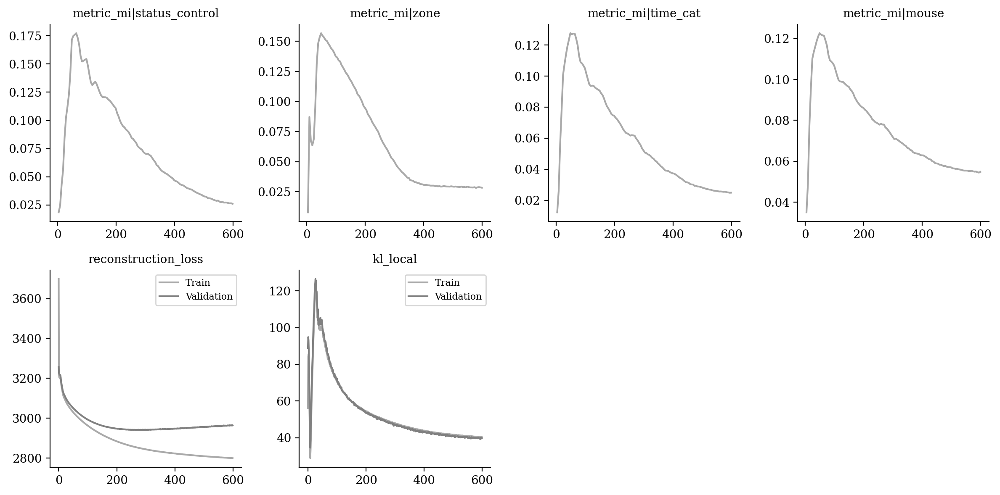

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

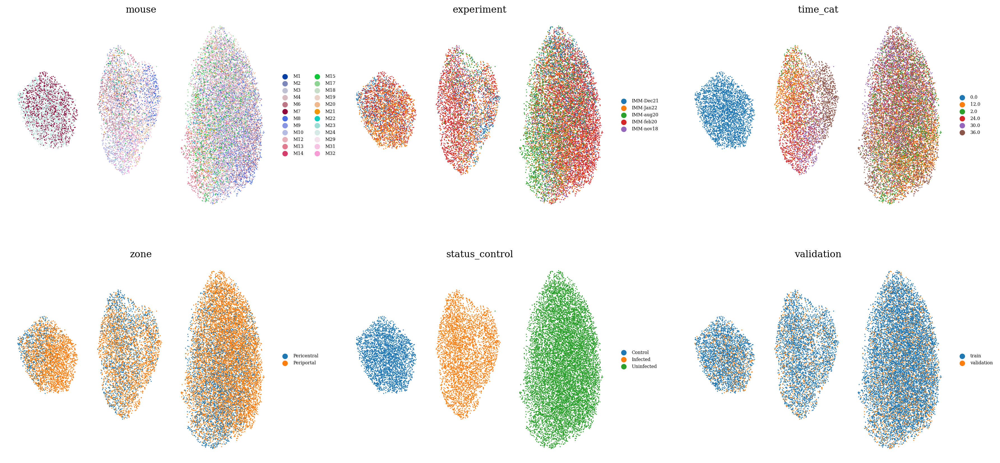

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

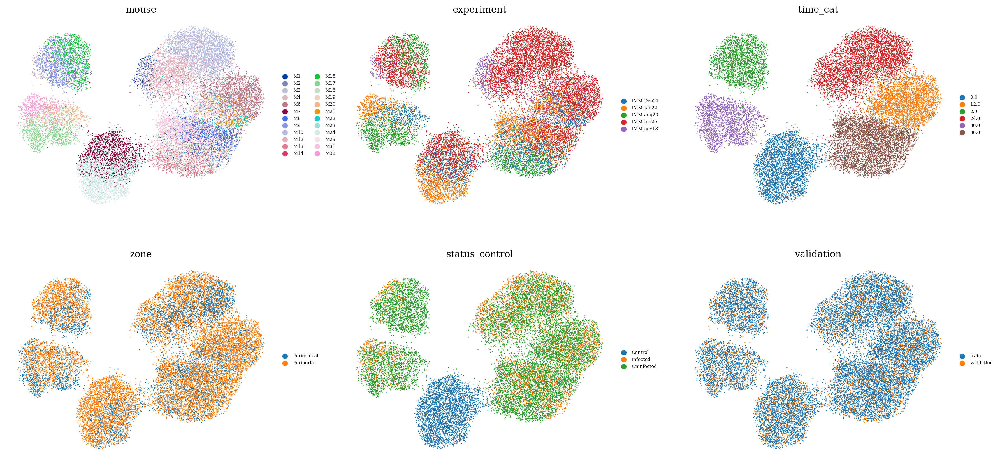

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

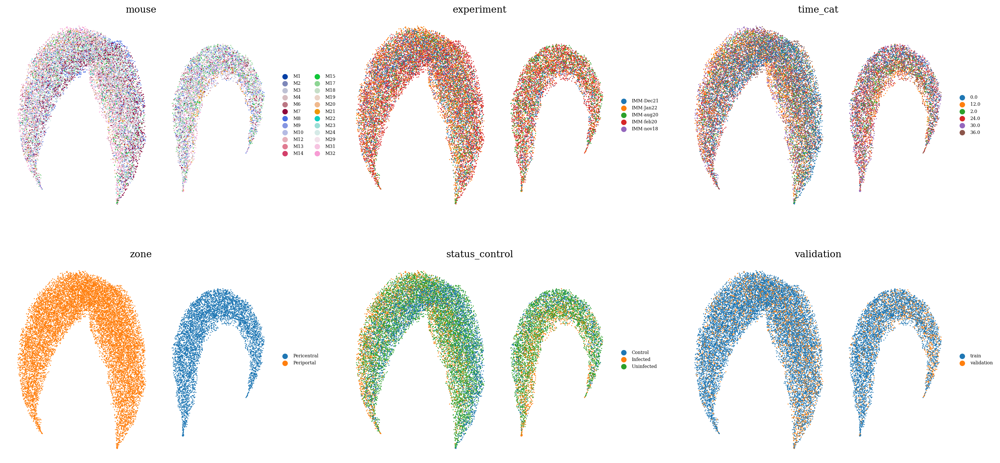

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

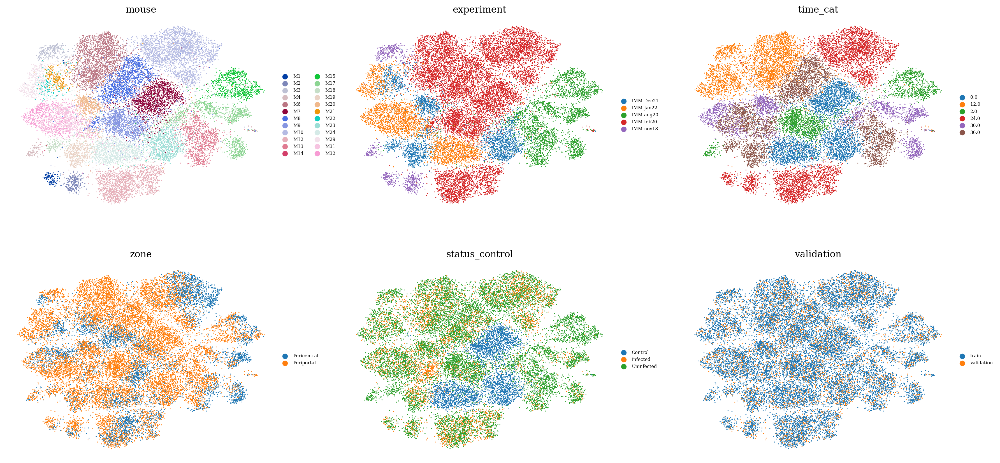

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

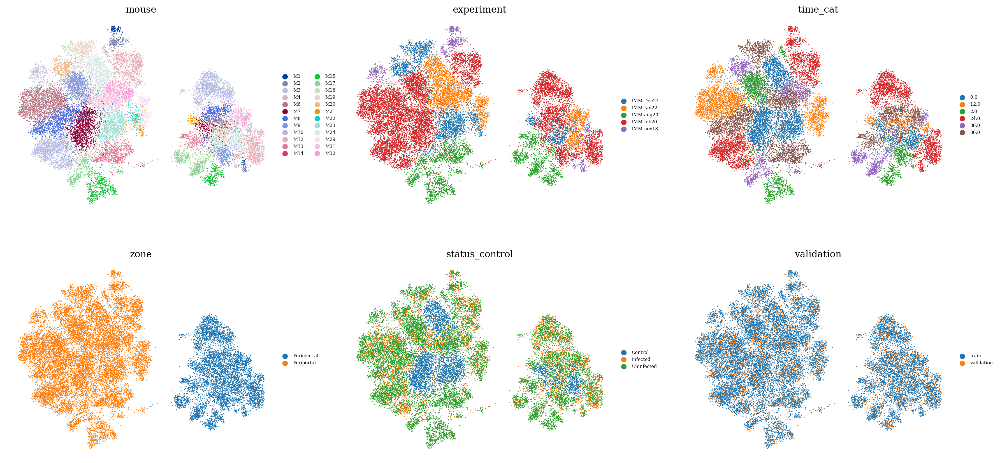

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

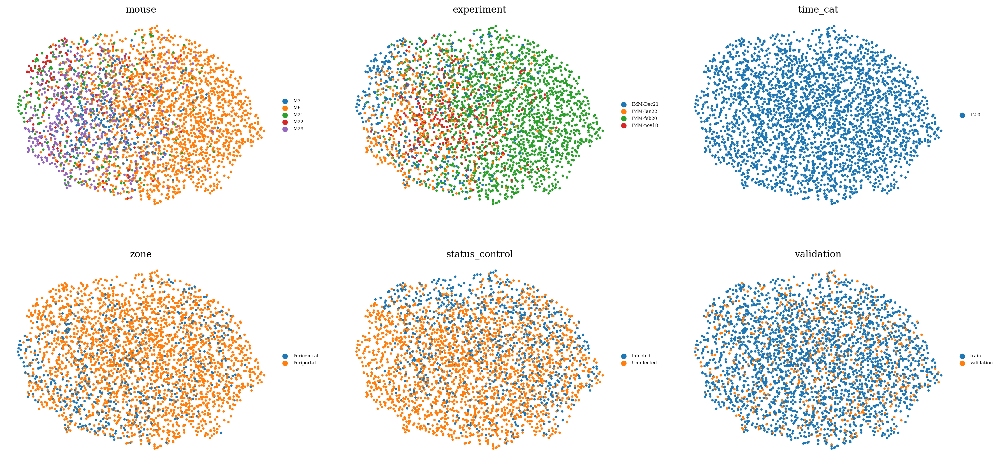

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )